In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.5/540.5 kB 7.2 MB/s eta 0:00:00


In [ ]:
pip install  lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=84e04c172c0a1f01ff8958a3e9c2a45a04472cbd60bc58ef2fa2f0750fe573b0
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
from sklearn.metrics import log_loss
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import RandomForestClassifier
from pprint import pprint
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import train_test_split
from sklearn import ensemble
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score,roc_auc_score,confusion_matrix
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, classification_report, confusion_matrix,r2_score
import warnings
from mlxtend.classifier import StackingClassifier
import missingno as msno
from sklearn.ensemble import VotingClassifier
import shap
import lime
from lime import lime_tabular
import os

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Ashifur Lab Work/Anxiety/Data/Anxiety_new.csv', index_col=False)
df.head()

,Age,Gender,Academic_Year,Current_CGPA,waiver_or_scholarship,GAD1,GAD2,GAD3,GAD4,GAD5,GAD6,GAD7,Anxiety Score,Output
0,18-22,Female,Fourth Year or Equivalent,2.50 - 2.99,No,1,1,1,2,2,2,1,10,Moderate Anxiety
1,18-22,Male,First Year or Equivalent,3.80 - 4.00,No,2,2,1,1,1,1,1,9,Mild Anxiety
2,18-22,Male,First Year or Equivalent,3.00 - 3.39,No,2,1,1,0,2,2,2,10,Moderate Anxiety
3,18-22,Male,First Year or Equivalent,3.40 - 3.79,No,2,1,1,1,1,1,1,8,Mild Anxiety
4,18-22,Male,First Year or Equivalent,3.40 - 3.79,No,1,1,1,1,1,1,1,7,Mild Anxiety


In [ ]:
df.shape

(1977, 14)

In [ ]:
# df.rename(columns={"1. Age": "Age", "2. Gender": "Gender","3. University":"University", "4. Department": "Department", "5. Academic Year": "Academic_Year",
#                             "6. Current CGPA":"Current_CGPA","7. Did you receive a waiver or scholarship at your university?": "waiver_or_scholarship",
#                    '1. In a semester, how often you felt nervous, anxious or on edge due to academic pressure?': 'GAD1',
#                   '2. In a semester, how often have you been unable to stop worrying about your academic affairs?':'GAD2',
#                   '3. In a semester, how often have you had trouble relaxing due to academic pressure?': 'GAD3',
#                   '4. In a semester, how often have you been easily annoyed or irritated because of academic pressure?': 'GAD4',
#                   '5. In a semester, how often have you worried too much about academic affairs?':'GAD5',
#                   '6. In a semester, how often have you been so restless due to academic pressure that it is hard to sit still?':'GAD6',
#                   '7. In a semester, how often have you felt afraid, as if something awful might happen?':'GAD7',
#                   'Anxiety Score (Max 21)':'Score','Anxiety Level\n04: minimal anxiety\n59: mild anxiety\n1014: moderate anxiety\n1521: severe anxiety':'Output' }, inplace=True)
# df.head()

In [ ]:
df = df.drop(['Anxiety Score'],axis = 1)
df.head()

,Age,Gender,Academic_Year,Current_CGPA,waiver_or_scholarship,GAD1,GAD2,GAD3,GAD4,GAD5,GAD6,GAD7,Output
0,18-22,Female,Fourth Year or Equivalent,2.50 - 2.99,No,1,1,1,2,2,2,1,Moderate Anxiety
1,18-22,Male,First Year or Equivalent,3.80 - 4.00,No,2,2,1,1,1,1,1,Mild Anxiety
2,18-22,Male,First Year or Equivalent,3.00 - 3.39,No,2,1,1,0,2,2,2,Moderate Anxiety
3,18-22,Male,First Year or Equivalent,3.40 - 3.79,No,2,1,1,1,1,1,1,Mild Anxiety
4,18-22,Male,First Year or Equivalent,3.40 - 3.79,No,1,1,1,1,1,1,1,Mild Anxiety


In [ ]:
df['Age'] = df['Age'].replace({'Below 18': 0, '18-22': 1, '23-26':2, '27-30': 3, 'Above 30':4})

In [ ]:
df['Gender'] = df['Gender'].replace({'Male': 0, 'Female': 1, 'Prefer not to say':2})

In [ ]:
df['Academic_Year'] = df['Academic_Year'].replace({"First Year or Equivalent":0 ,
"Second Year or Equivalent":1 ,
"Third Year or Equivalent":2 ,
"Fourth Year or Equivalent":3 ,
"Other":4})

In [ ]:
df['Current_CGPA'] = df['Current_CGPA'].replace({
"Below 2.50":0 ,
"2.50 - 2.99":1 ,
"3.00 - 3.39":2 ,
"3.40 - 3.79":3 ,
"3.80 - 4.00":4,
"Other":5})

In [ ]:
df['waiver_or_scholarship'] = df['waiver_or_scholarship'].replace({"Yes":0 ,
"No":1})

In [ ]:
df.head()

,Age,Gender,Academic_Year,Current_CGPA,waiver_or_scholarship,GAD1,GAD2,GAD3,GAD4,GAD5,GAD6,GAD7,Output
0,1,1,3,1,1,1,1,1,2,2,2,1,Moderate Anxiety
1,1,0,0,4,1,2,2,1,1,1,1,1,Mild Anxiety
2,1,0,0,2,1,2,1,1,0,2,2,2,Moderate Anxiety
3,1,0,0,3,1,2,1,1,1,1,1,1,Mild Anxiety
4,1,0,0,3,1,1,1,1,1,1,1,1,Mild Anxiety


In [ ]:
df['Output'].value_counts()

Output
Severe Anxiety      714
Moderate Anxiety    610
Mild Anxiety        495
Minimal Anxiety     158
Name: count, dtype: int64

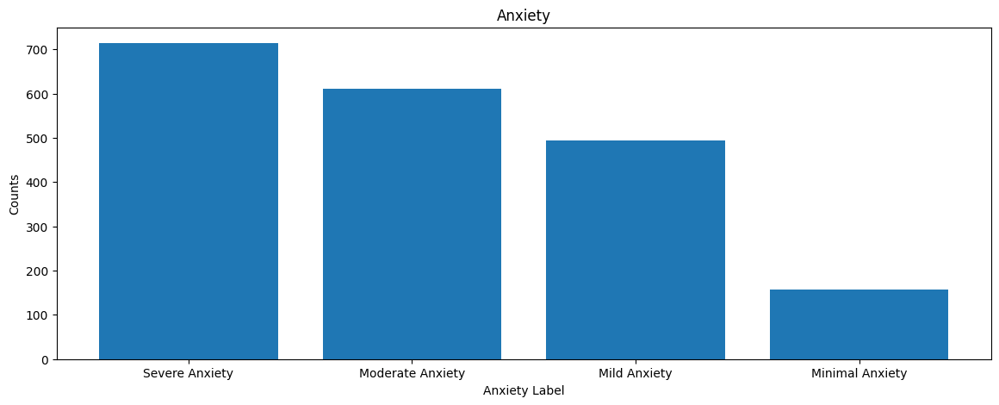

In [ ]:
output_counts = df['Output'].value_counts()

# Plotting
plt.figure(figsize=(14, 5))
plt.bar(output_counts.index, output_counts.values)
plt.xlabel('Anxiety Label')
plt.ylabel('Counts')
plt.title('Anxiety')
plt.show()

In [ ]:
df['Output'] = df['Output'].replace({"Minimal Anxiety":0 ,
"Mild Anxiety":1,
"Moderate Anxiety":2,
"Severe Anxiety":3})

In [ ]:
df.head()

,Age,Gender,Academic_Year,Current_CGPA,waiver_or_scholarship,GAD1,GAD2,GAD3,GAD4,GAD5,GAD6,GAD7,Output
0,1,1,3,1,1,1,1,1,2,2,2,1,2
1,1,0,0,4,1,2,2,1,1,1,1,1,1
2,1,0,0,2,1,2,1,1,0,2,2,2,2
3,1,0,0,3,1,2,1,1,1,1,1,1,1
4,1,0,0,3,1,1,1,1,1,1,1,1,1


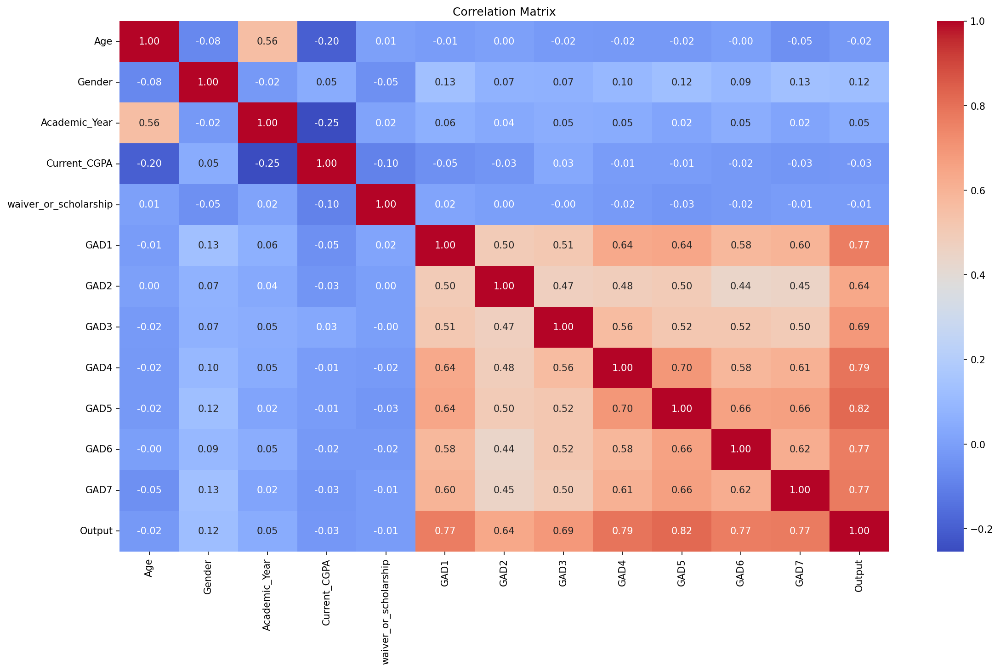

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(18, 10),dpi=150)
correlation_matrix = df.corr()
# Plot correlation matrix heatmap
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

In [ ]:
# Data for all the independent variables
X = df.drop(labels='Output',axis=1)

# Data for the dependent variable
y = df['Output']

In [ ]:
X.shape

(1977, 12)

In [ ]:
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state = 2)
X_res, y_res = sm.fit_resample(X, y.ravel())

In [ ]:
X_res.shape

(2856, 12)

In [ ]:
from sklearn.model_selection import train_test_split
# Train-test split

X_train, X_test, Y_train, Y_test = train_test_split(X_res,y_res,test_size = 0.20, random_state=1)

In [ ]:
# Check the shape of train dataset
print(X_train.shape,Y_train.shape)

# Check the shape of test dataset
print(X_test.shape, Y_test.shape)

(2284, 12) (2284,)
(572, 12) (572,)


# **Machine Learning Model**

In [ ]:
acc = []
pre = []
rec = []
score = []
ml_model = []

# **Decision Tree**

In [ ]:
from sklearn.tree import DecisionTreeClassifier

# Create Decision Tree classifier
classifier = DecisionTreeClassifier()
# Define the parameter grid
param_grid = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [None, 5, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Perform GridSearchCV
grid_search = GridSearchCV(classifier, param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, Y_train)

# Get the best parameters
best_params = grid_search.best_params_
print("Best Parameters:", best_params)

Best Parameters: {'criterion': 'entropy', 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2}


In [ ]:
# Initialize RandomForestClassifier with best parameters
dt_classifier = DecisionTreeClassifier(criterion='entropy', max_depth=20, min_samples_leaf=1, min_samples_split=2)

# You can now train your model using the best parameters
dt_classifier.fit(X_train, Y_train)

# Once trained, you can use the model for predictions
x_pred = dt_classifier.predict(X_train)
y_pred = dt_classifier.predict(X_test)

In [ ]:
# Calculating accuracy on train and test
train_accuracy = accuracy_score(Y_train,x_pred)
test_accuracy = accuracy_score(Y_test,y_pred)
print("Train Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)

Train Accuracy: 1.0
Test Accuracy: 0.9178321678321678


In [ ]:
# Calculate precision, recall, and F1-score
precision = precision_score(Y_test,y_pred, average='weighted')
recall = recall_score(Y_test,y_pred, average='weighted')
f1 = f1_score(Y_test,y_pred, average='weighted')

print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)


acc.append(test_accuracy)
pre.append(precision)
rec.append(recall)
score.append(f1)
ml_model.append('Decision Tree')

Precision: 0.917884962553502
Recall: 0.9178321678321678
F1-score: 0.9177849129995348


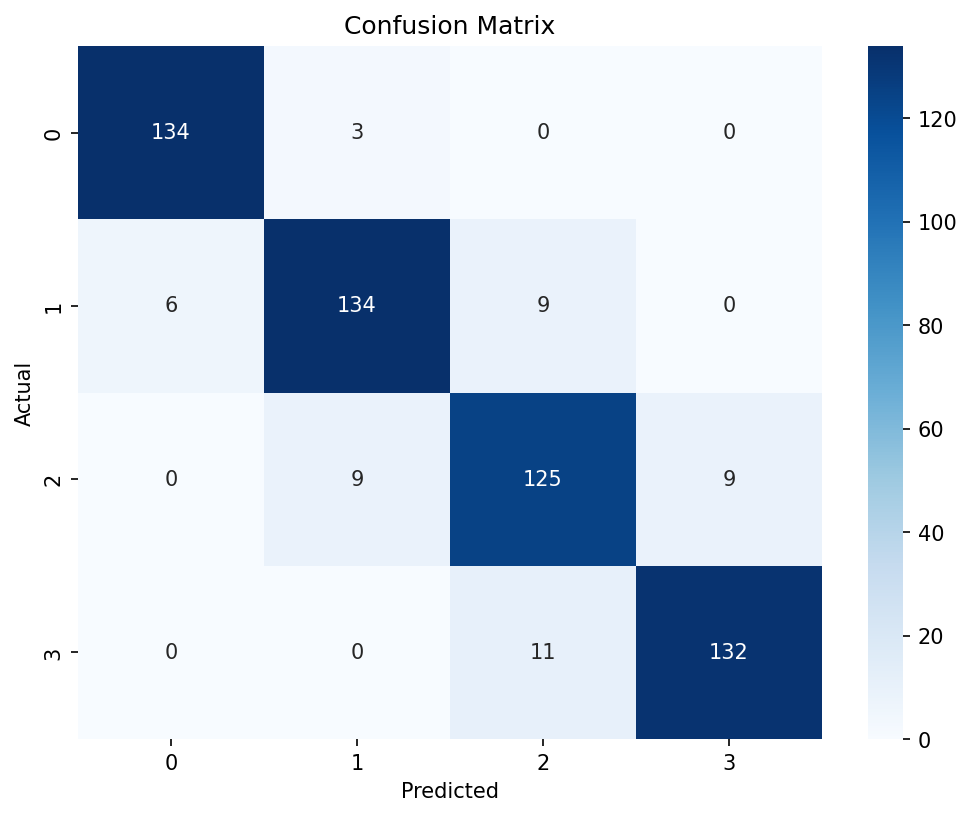

In [ ]:
conf_matrix = confusion_matrix(Y_test,y_pred)


plt.figure(figsize=(8, 6), dpi = 150)
sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

In [ ]:
classes = np.array(["Minimal Anxiety", "Mild Anxiety", "Moderate Anxiety","Severe Anxiety"])
classes.shape[0]

4

/usr/local/lib/python3.10/dist-packages/sklearn/multiclass.py:492: RuntimeWarning: invalid value encountered in divide
  Y /= np.sum(Y, axis=1)[:, np.newaxis]


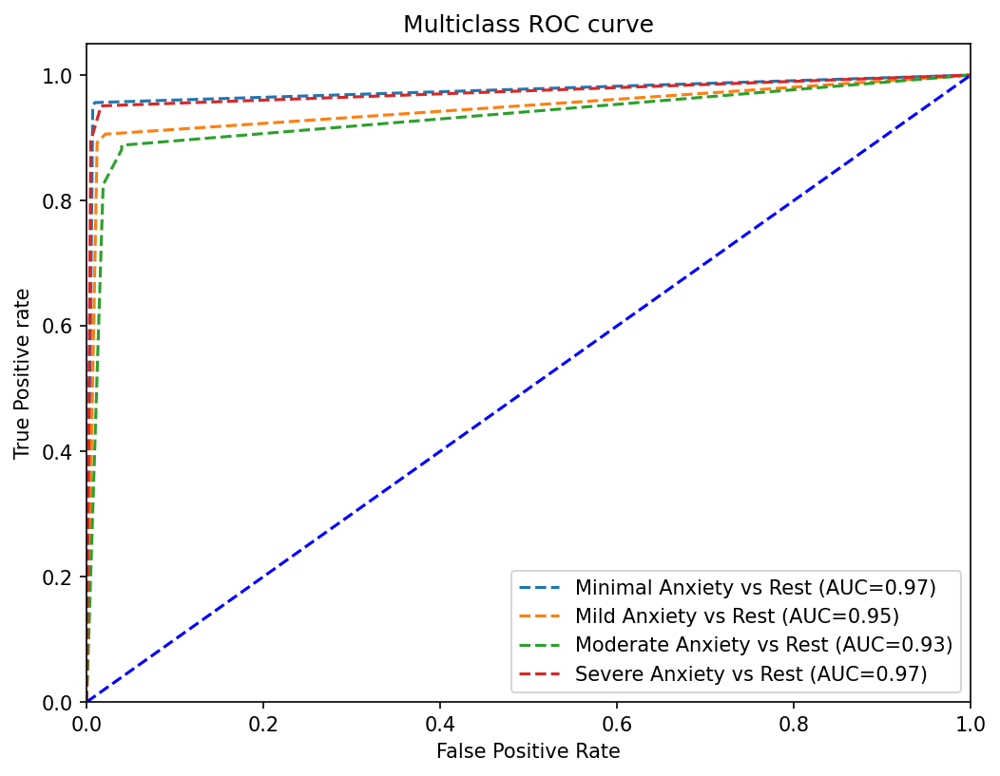

In [ ]:
import numpy as np
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier

plt.figure(figsize=(8, 6), dpi=150)

# Check for NaN or infinite values in X_test
nan_indices_X_test = np.isnan(X_test)
inf_indices_X_test = np.isinf(X_test)
if np.any(nan_indices_X_test) or np.any(inf_indices_X_test):
    # Handle NaN or infinite values
    # For example, you can replace NaN values with a specific value or drop them
    X_test[nan_indices_X_test] = 0  # Replace NaN with 0
    X_test[inf_indices_X_test] = np.finfo(X_test.dtype).max  # Replace infinite values with the maximum value of the dtype

n_classes = classes.shape[0]

# Train classifier
classifier = OneVsRestClassifier(dt_classifier)
classifier.fit(X_train, Y_train)
y_score = classifier.predict_proba(X_test)

y_test_binarized = label_binarize(Y_test, classes=np.unique(Y_test))

# Check for NaN or infinite values in y_score
nan_indices_y_score = np.isnan(y_score)
inf_indices_y_score = np.isinf(y_score)
if np.any(nan_indices_y_score) or np.any(inf_indices_y_score):
    # Handle NaN or infinite values
    # For example, you can replace NaN values with a specific value or drop them
    y_score[nan_indices_y_score] = 0  # Replace NaN with 0
    y_score[inf_indices_y_score] = np.finfo(y_score.dtype).max  # Replace infinite values with the maximum value of the dtype

# roc curve for classes
fpr = {}
tpr = {}
thresh = {}
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], thresh[i] = roc_curve(y_test_binarized[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

    # plotting
    plt.plot(fpr[i], tpr[i], linestyle='--',
             label='%s vs Rest (AUC=%0.2f)' % (classes[i], roc_auc[i]))

plt.plot([0, 1], [0, 1], 'b--')
plt.xlim([0, 1])
plt.ylim([0, 1.05])
plt.title('Multiclass ROC curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive rate')
plt.legend(loc='lower right')
plt.show()

In [ ]:
#Checking importance of features
importances = dt_classifier.feature_importances_

#List of columns and their importances
importance_dict = {'Feature' : list(X_train.columns),
                    'Feature Importance' : importances}
#Creating a dataframe
importance_df = pd.DataFrame(importance_dict)

#Rounding it off to 2 digits as we might get exponential numbers
importance_df['Feature Importance'] = round(importance_df['Feature Importance'],2)
importance_df.sort_values(by=['Feature Importance'],ascending=False)

,Feature,Feature Importance
9,GAD5,0.34
11,GAD7,0.20
8,GAD4,0.11
6,GAD2,0.11
7,GAD3,0.08
10,GAD6,0.08
5,GAD1,0.04
3,Current_CGPA,0.02
2,Academic_Year,0.01
1,Gender,0.00


In [ ]:
def check_importance(model, X_train):
  #Checking importance of features
  importances = model.feature_importances_

  #List of columns and their importances
  importance_dict = {'Feature' : list(X_train.columns),
                    'Feature Importance' : importances}
  #Creating a dataframe
  importance_df = pd.DataFrame(importance_dict)

  #Rounding it off to 2 digits as we might get exponential numbers
  importance_df['Feature Importance'] = round(importance_df['Feature Importance'],2)
  return importance_df.sort_values(by=['Feature Importance'],ascending=False)

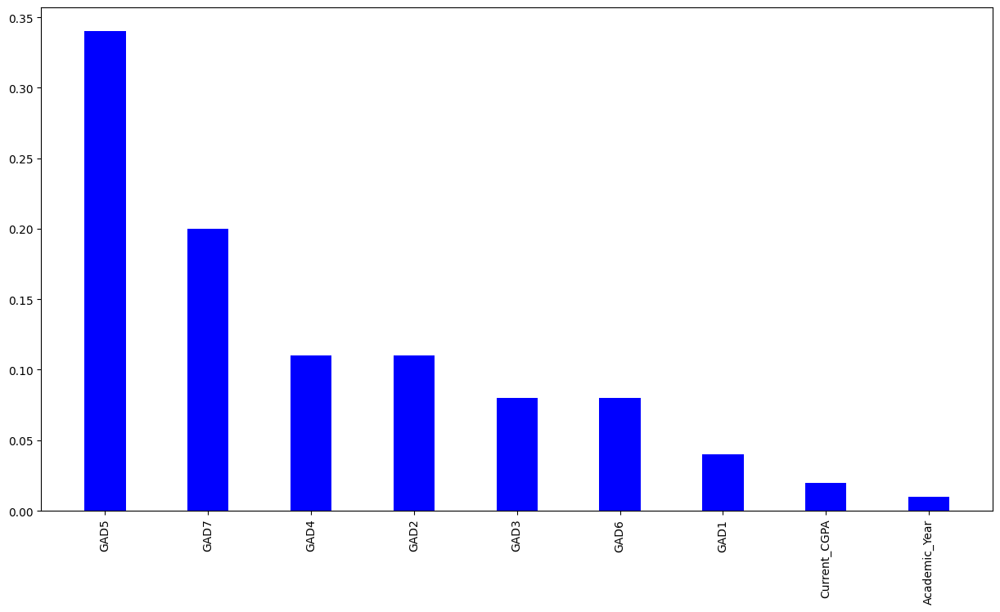

In [ ]:
# PLotting features vs their importance factors
fig = plt.figure(figsize = (15, 8))

# Extracting importance values
values =check_importance(dt_classifier, X_train)[check_importance(dt_classifier, X_train)['Feature Importance']>0]['Feature Importance'].values


# Extracting importance features
features = check_importance(dt_classifier, X_train)[check_importance(dt_classifier, X_train)['Feature Importance']>0]['Feature'].values

plt.bar(features, values, color ='blue',width = 0.4)
plt.xticks( rotation='vertical')
plt.show()

In [ ]:
# This function will show how a feature is pushing towards 0 or 1
def interpret_with_lime(model, X_test):
  # New data
  interpretor = lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train),
    feature_names=X_train.columns,
    mode='classification')


  exp = interpretor.explain_instance(
      data_row=X_test.iloc[10],
      predict_fn=model.predict_proba
  )

  exp.show_in_notebook(show_table=True)

In [ ]:
# Interpretting the model using lime
interpret_with_lime(dt_classifier,X_test)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


# **Random Forest Classifier**

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

# Number of trees
n_estimators = [50, 80, 100]

# Maximum depth of trees
max_depth = [4, 6, 8]

# Minimum number of samples required to split a node
min_samples_split = [50, 100, 150]

# Minimum number of samples required at each leaf node
min_samples_leaf = [40, 50]

# Hyperparameter Grid
rf_parameters = {'n_estimators': n_estimators,
                 'max_depth': max_depth,
                 'min_samples_split': min_samples_split,
                 'min_samples_leaf': min_samples_leaf}

# Initialize RandomForestClassifier with GridSearchCV
rf_classifier = RandomForestClassifier()

# Grid search with cross-validation
grid_search = GridSearchCV(estimator=rf_classifier, param_grid=rf_parameters, cv=5)

# You can fit your data to the grid search object like this:
grid_search.fit(X_train, Y_train)

# After fitting, you can access the best parameters using:
grid_search.best_params_

{'max_depth': 6,
 'min_samples_leaf': 40,
 'min_samples_split': 50,
 'n_estimators': 100}

In [ ]:
# Best parameters from grid search
best_params = {'max_depth': 8,
               'min_samples_leaf': 40,
               'min_samples_split': 100,
               'n_estimators': 100}

# Initialize RandomForestClassifier with best parameters
rf_classifier = RandomForestClassifier(**best_params)

# You can now train your model using the best parameters
rf_classifier.fit(X_train, Y_train)

# Once trained, you can use the model for predictions
x_pred = rf_classifier.predict(X_train)
y_pred = rf_classifier.predict(X_test)

In [ ]:
# Calculating accuracy on train and test
train_accuracy = accuracy_score(Y_train,x_pred)
test_accuracy = accuracy_score(Y_test,y_pred)
print("Train Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)

Train Accuracy: 0.9106830122591943
Test Accuracy: 0.9038461538461539


In [ ]:
# Calculate precision, recall, and F1-score
precision = precision_score(Y_test,y_pred, average='weighted')
recall = recall_score(Y_test,y_pred, average='weighted')
f1 = f1_score(Y_test,y_pred, average='weighted')

print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)


acc.append(test_accuracy)
pre.append(precision)
rec.append(recall)
score.append(f1)
ml_model.append('Random Forest')

Precision: 0.9058498337997881
Recall: 0.9038461538461539
F1-score: 0.9044655751294672


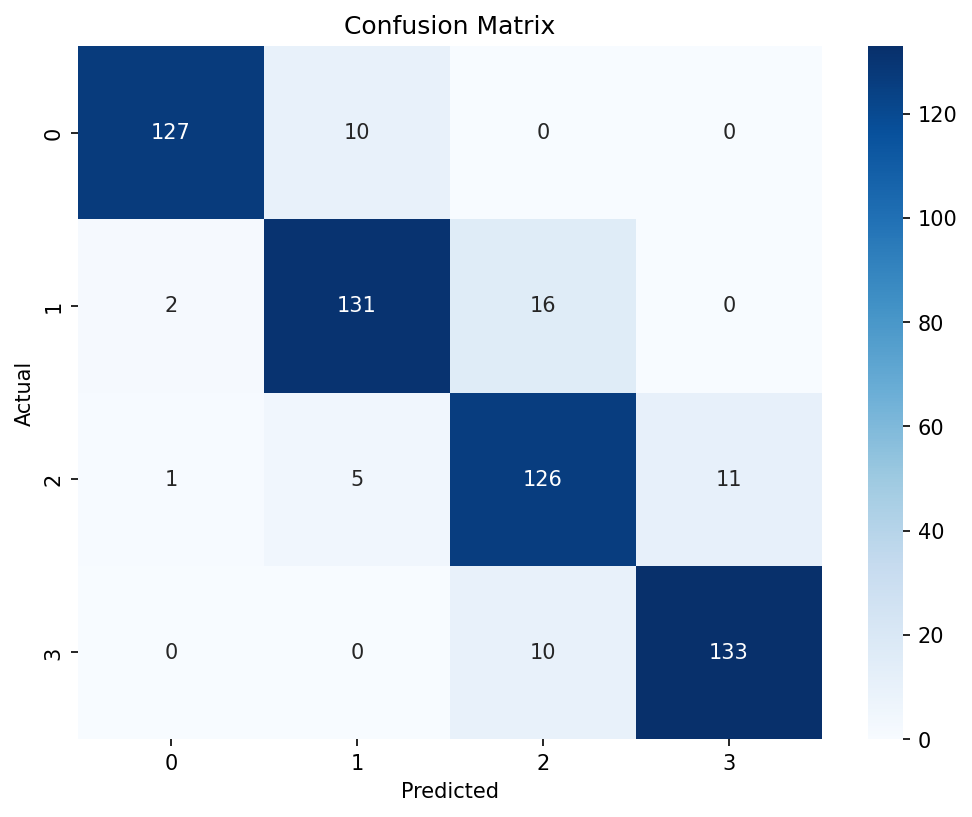

In [ ]:
conf_matrix = confusion_matrix(Y_test,y_pred)


plt.figure(figsize=(8, 6), dpi = 150)
sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

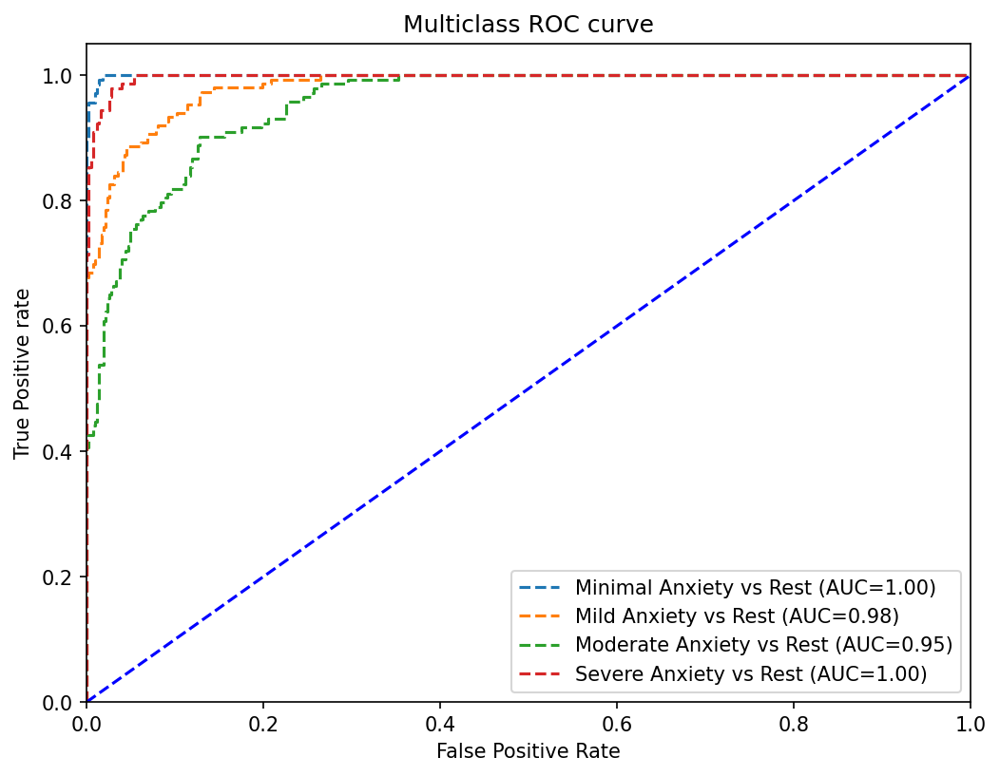

In [ ]:
plt.figure(figsize=(8, 6),dpi=150)
n_classes = classes.shape[0]
# Train classifier
classifier = OneVsRestClassifier(rf_classifier)
classifier.fit(X_train, Y_train)
y_score = classifier.predict_proba(X_test)

y_test_binarized=label_binarize(Y_test,classes=np.unique(Y_test))

# roc curve for classes
fpr = {}
tpr = {}
thresh ={}
roc_auc = dict()


for i in range(n_classes):
    fpr[i], tpr[i], thresh[i] = roc_curve(y_test_binarized[:,i], y_score[:,i])
    roc_auc[i] = auc(fpr[i], tpr[i])

    # plotting
    plt.plot(fpr[i], tpr[i], linestyle='--',
             label='%s vs Rest (AUC=%0.2f)'%(classes[i],roc_auc[i]))


plt.plot([0,1],[0,1],'b--')
plt.xlim([0,1])
plt.ylim([0,1.05])
plt.title('Multiclass ROC curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive rate')
plt.legend(loc='lower right')
plt.show()

In [ ]:
#Checking importance of features
importances = rf_classifier.feature_importances_

#List of columns and their importances
importance_dict = {'Feature' : list(X_train.columns),
                    'Feature Importance' : importances}
#Creating a dataframe
importance_df = pd.DataFrame(importance_dict)

#Rounding it off to 2 digits as we might get exponential numbers
importance_df['Feature Importance'] = round(importance_df['Feature Importance'],2)
importance_df.sort_values(by=['Feature Importance'],ascending=False)

,Feature,Feature Importance
9,GAD5,0.22
8,GAD4,0.19
11,GAD7,0.18
10,GAD6,0.13
7,GAD3,0.10
5,GAD1,0.10
6,GAD2,0.08
0,Age,0.00
3,Current_CGPA,0.00
2,Academic_Year,0.00


In [ ]:
def check_importance(model, X_train):
  #Checking importance of features
  importances = model.feature_importances_

  #List of columns and their importances
  importance_dict = {'Feature' : list(X_train.columns),
                    'Feature Importance' : importances}
  #Creating a dataframe
  importance_df = pd.DataFrame(importance_dict)

  #Rounding it off to 2 digits as we might get exponential numbers
  importance_df['Feature Importance'] = round(importance_df['Feature Importance'],2)
  return importance_df.sort_values(by=['Feature Importance'],ascending=False)


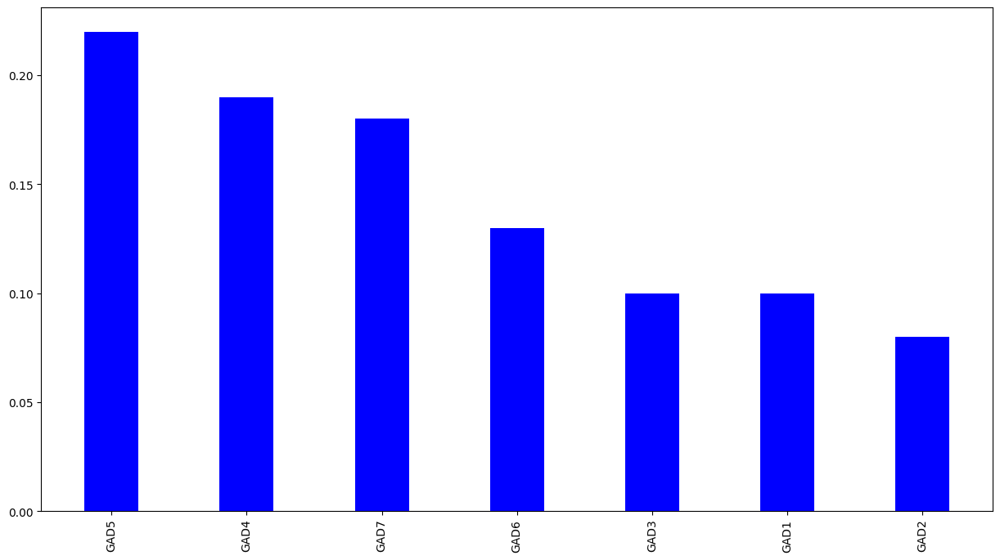

In [ ]:
# PLotting features vs their importance factors
fig = plt.figure(figsize = (15, 8))

# Extracting importance values
values =check_importance(rf_classifier, X_train)[check_importance(rf_classifier, X_train)['Feature Importance']>0]['Feature Importance'].values


# Extracting importance features
features = check_importance(rf_classifier, X_train)[check_importance(rf_classifier, X_train)['Feature Importance']>0]['Feature'].values

plt.bar(features, values, color ='blue',width = 0.4)
plt.xticks( rotation='vertical')
plt.show()

Could be used in the Paper

In [ ]:
# Interpretting the model using lime
interpret_with_lime(rf_classifier,X_test)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


# **Gradient Boosting**

In [ ]:
#finding the best model
gb_parameters ={
    "n_estimators":[5,50,250],
    "max_depth":[1,3,5,7],
    "learning_rate":[0.01,0.1,1]
}

gbc = GradientBoostingClassifier()
gbc_search = GridSearchCV(estimator=gbc, param_grid=gb_parameters, cv=5)

# You can fit your data to the grid search object like this:
gbc_search.fit(X_train, Y_train)

# After fitting, you can access the best parameters using:
gbc_search.best_params_

{'learning_rate': 1, 'max_depth': 1, 'n_estimators': 250}

In [ ]:
best_gbc = GradientBoostingClassifier(learning_rate=1, max_depth=1, n_estimators=250)
# You can now train your model using the best parameters
best_gbc.fit(X_train, Y_train)

# Once trained, you can use the model for predictions
x_pred = best_gbc.predict(X_train)
y_pred = best_gbc.predict(X_test)

In [ ]:
# Calculating accuracy on train and test
train_accuracy = accuracy_score(Y_train,x_pred)
test_accuracy = accuracy_score(Y_test,y_pred)
print("Train Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)

Train Accuracy: 0.9947460595446584
Test Accuracy: 0.9737762237762237


In [ ]:
# Calculate precision, recall, and F1-score
precision = precision_score(Y_test,y_pred, average='weighted')
recall = recall_score(Y_test,y_pred, average='weighted')
f1 = f1_score(Y_test,y_pred, average='weighted')

print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)


acc.append(test_accuracy)
pre.append(precision)
rec.append(recall)
score.append(f1)
ml_model.append('Gradient Boosting')

Precision: 0.9736906860847384
Recall: 0.9737762237762237
F1-score: 0.9737041865032016


In [ ]:
print(acc)
print(pre)
print(rec)
print(score)
print(ml_model)

[0.9178321678321678, 0.9038461538461539, 0.9737762237762237]
[0.917884962553502, 0.9058498337997881, 0.9736906860847384]
[0.9178321678321678, 0.9038461538461539, 0.9737762237762237]
[0.9177849129995348, 0.9044655751294672, 0.9737041865032016]
['Decision Tree', 'Random Forest', 'Gradient Boosting']


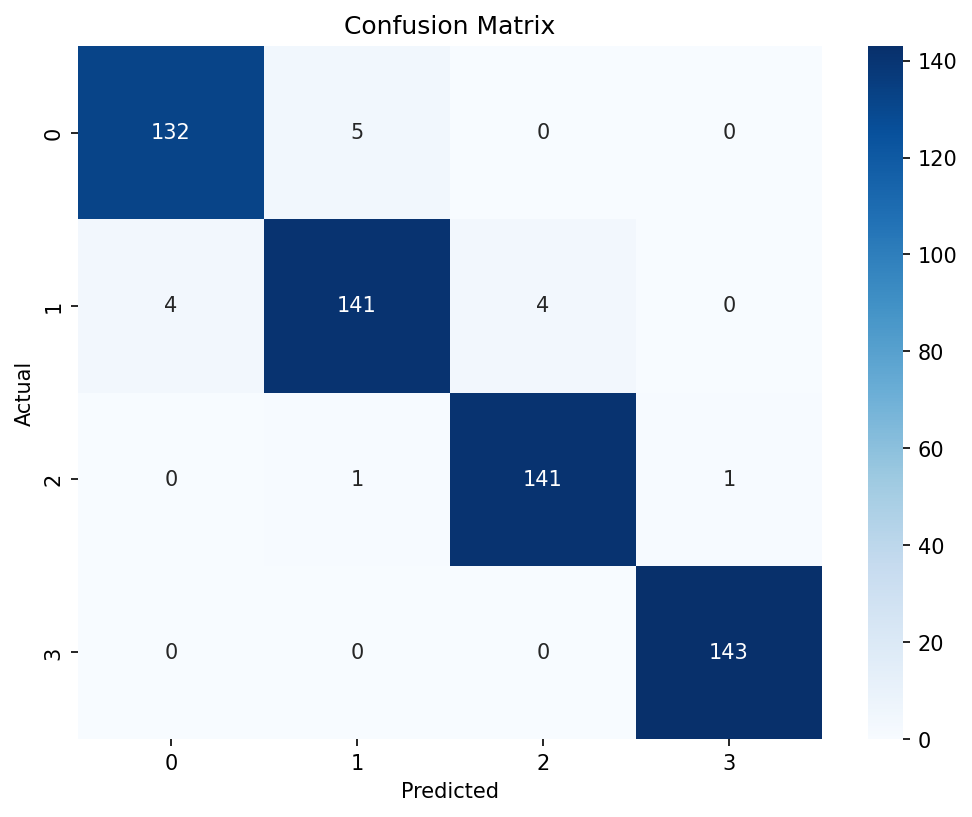

In [ ]:
conf_matrix = confusion_matrix(Y_test,y_pred)


plt.figure(figsize=(8, 6), dpi = 150)
sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

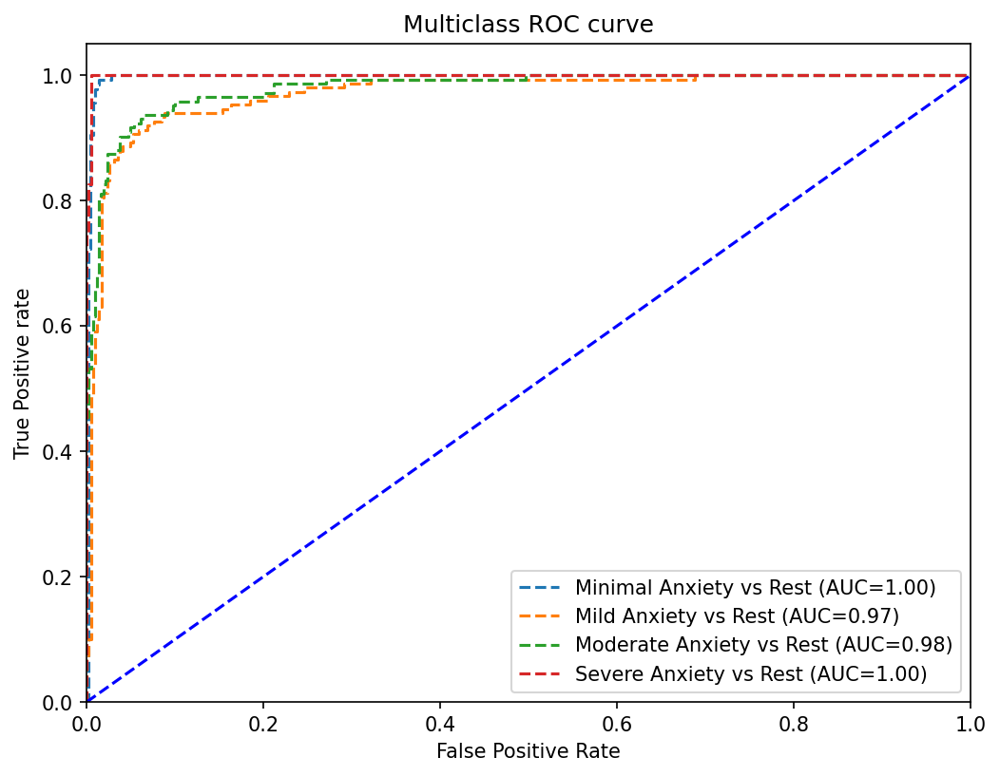

In [ ]:
plt.figure(figsize=(8, 6),dpi=150)
n_classes = classes.shape[0]
# Train classifier
classifier = OneVsRestClassifier(best_gbc)
classifier.fit(X_train, Y_train)
y_score = classifier.predict_proba(X_test)

y_test_binarized=label_binarize(Y_test,classes=np.unique(Y_test))

# roc curve for classes
fpr = {}
tpr = {}
thresh ={}
roc_auc = dict()


for i in range(n_classes):
    fpr[i], tpr[i], thresh[i] = roc_curve(y_test_binarized[:,i], y_score[:,i])
    roc_auc[i] = auc(fpr[i], tpr[i])

    # plotting
    plt.plot(fpr[i], tpr[i], linestyle='--',
             label='%s vs Rest (AUC=%0.2f)'%(classes[i],roc_auc[i]))


plt.plot([0,1],[0,1],'b--')
plt.xlim([0,1])
plt.ylim([0,1.05])
plt.title('Multiclass ROC curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive rate')
plt.legend(loc='lower right')
plt.show()

In [ ]:
#Checking importance of features
importances = best_gbc.feature_importances_

#List of columns and their importances
importance_dict = {'Feature' : list(X_train.columns),
                    'Feature Importance' : importances}
#Creating a dataframe
importance_df = pd.DataFrame(importance_dict)

#Rounding it off to 2 digits as we might get exponential numbers
importance_df['Feature Importance'] = round(importance_df['Feature Importance'],2)
importance_df.sort_values(by=['Feature Importance'],ascending=False)

,Feature,Feature Importance
9,GAD5,0.40
8,GAD4,0.35
10,GAD6,0.08
7,GAD3,0.06
5,GAD1,0.04
6,GAD2,0.03
11,GAD7,0.03
0,Age,0.00
3,Current_CGPA,0.00
2,Academic_Year,0.00


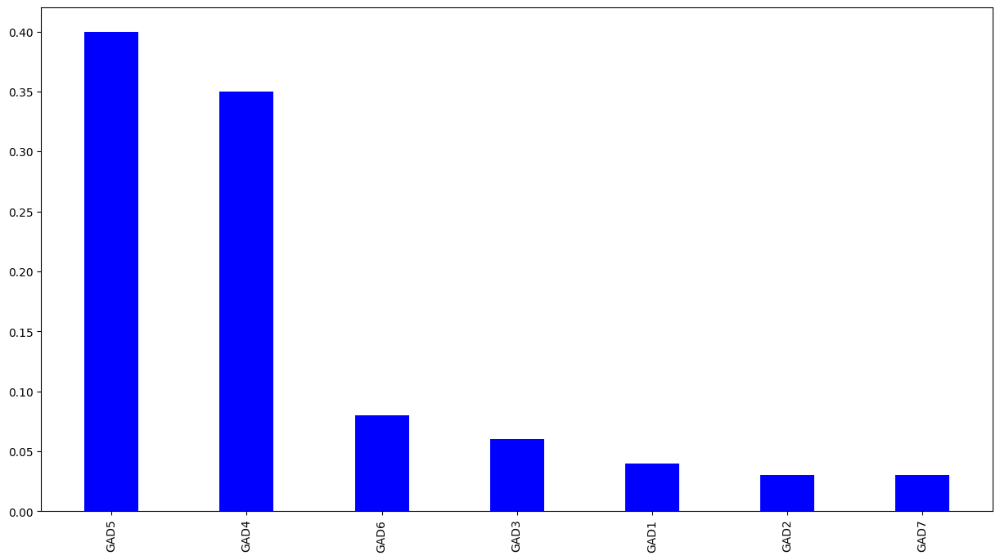

In [ ]:
# PLotting features vs their importance factors
fig = plt.figure(figsize = (15, 8))

# Extracting importance values
values =check_importance(best_gbc, X_train)[check_importance(best_gbc, X_train)['Feature Importance']>0]['Feature Importance'].values


# Extracting importance features
features = check_importance(best_gbc, X_train)[check_importance(best_gbc, X_train)['Feature Importance']>0]['Feature'].values

plt.bar(features, values, color ='blue',width = 0.4)
plt.xticks( rotation='vertical')
plt.show()

In [ ]:
# Interpretting the model using lime
interpret_with_lime(best_gbc,X_test)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  warnings.warn(


# **XGBOOST**

In [ ]:
# Parameter grid for xgboost
xgb_parameters = {'max_depth': [1,3,5], 'n_estimators': [2,5,10], 'learning_rate': [.01 , .1, .5]}

xgb_classifier = XGBClassifier()

grid_search = GridSearchCV(estimator=xgb_classifier, param_grid=xgb_parameters, cv=5)

# You can fit your data to the grid search object like this:
grid_search.fit(X_train, Y_train)

# After fitting, you can access the best parameters using:
grid_search.best_params_

{'learning_rate': 0.5, 'max_depth': 5, 'n_estimators': 10}

In [ ]:
best_xgb = XGBClassifier(learning_rate = 0.5, max_depth = 5, n_estimators = 10)
# You can now train your model using the best parameters
best_xgb.fit(X_train, Y_train)

# Once trained, you can use the model for predictions
x_pred = best_xgb.predict(X_train)
y_pred = best_xgb.predict(X_test)

In [ ]:
# Calculating accuracy on train and test
train_accuracy = accuracy_score(Y_train,x_pred)
test_accuracy = accuracy_score(Y_test,y_pred)
print("Train Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)

Train Accuracy: 0.9899299474605955
Test Accuracy: 0.9562937062937062


In [ ]:
# Calculate precision, recall, and F1-score
precision = precision_score(Y_test,y_pred, average='weighted')
recall = recall_score(Y_test,y_pred, average='weighted')
f1 = f1_score(Y_test,y_pred, average='weighted')

print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)


acc.append(test_accuracy)
pre.append(precision)
rec.append(recall)
score.append(f1)
ml_model.append('XGBoost')

Precision: 0.9563545567330702
Recall: 0.9562937062937062
F1-score: 0.9562955660809787


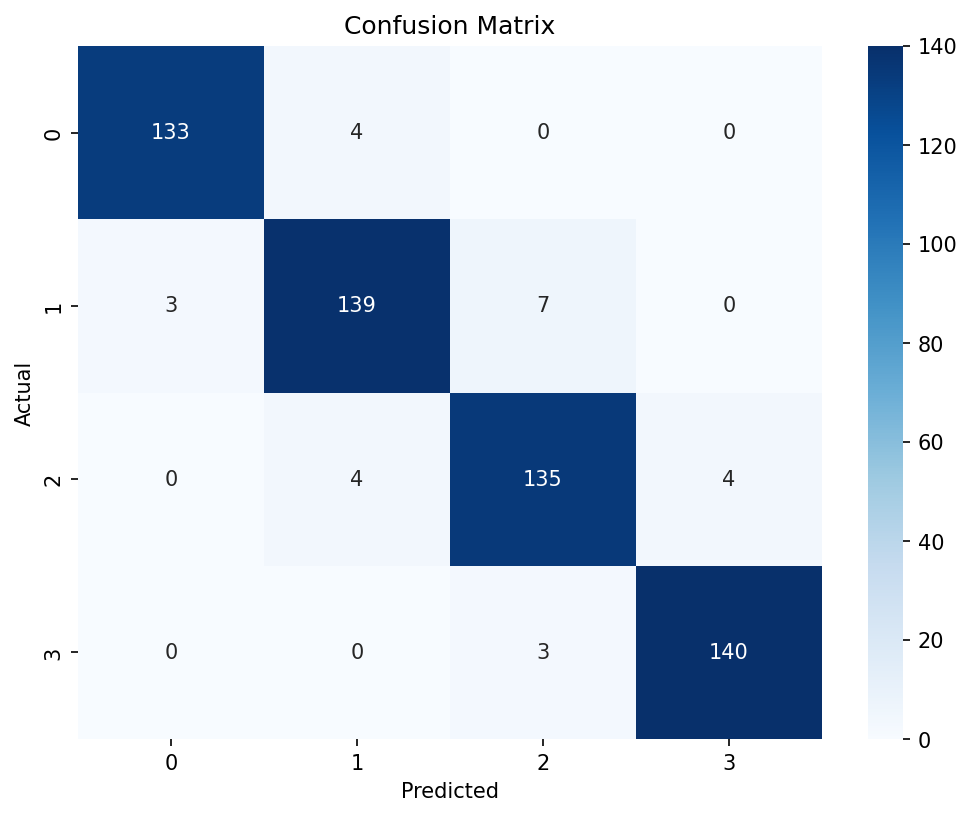

In [ ]:
conf_matrix = confusion_matrix(Y_test,y_pred)


plt.figure(figsize=(8, 6),dpi = 150)
sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

In [ ]:
# plt.figure(figsize=(8, 6),dpi=150)
# n_classes = classes.shape[0]
# # Train classifier
# classifier = OneVsRestClassifier(best_xgb)
# classifier.fit(X_train, Y_train)
# y_score = classifier.predict_proba(X_test)

# y_test_binarized=label_binarize(Y_test,classes=np.unique(Y_test))

# # roc curve for classes
# fpr = {}
# tpr = {}
# thresh ={}
# roc_auc = dict()


# for i in range(n_classes):
#     fpr[i], tpr[i], thresh[i] = roc_curve(y_test_binarized[:,i], y_score[:,i])
#     roc_auc[i] = auc(fpr[i], tpr[i])

#     # plotting
#     plt.plot(fpr[i], tpr[i], linestyle='--',
#              label='%s vs Rest (AUC=%0.2f)'%(classes[i],roc_auc[i]))


# plt.plot([0,1],[0,1],'b--')
# plt.xlim([0,1])
# plt.ylim([0,1.05])
# plt.title('Multiclass ROC curve')
# plt.xlabel('False Positive Rate')
# plt.ylabel('True Positive rate')
# plt.legend(loc='lower right')
# plt.show()

In [ ]:
#Checking importance of features
importances = best_xgb.feature_importances_

#List of columns and their importances
importance_dict = {'Feature' : list(X_train.columns),
                    'Feature Importance' : importances}
#Creating a dataframe
importance_df = pd.DataFrame(importance_dict)

#Rounding it off to 2 digits as we might get exponential numbers
importance_df['Feature Importance'] = round(importance_df['Feature Importance'],2)
importance_df.sort_values(by=['Feature Importance'],ascending=False)

,Feature,Feature Importance
8,GAD4,0.24
9,GAD5,0.24
11,GAD7,0.17
7,GAD3,0.09
6,GAD2,0.09
10,GAD6,0.08
5,GAD1,0.06
0,Age,0.01
2,Academic_Year,0.01
3,Current_CGPA,0.01


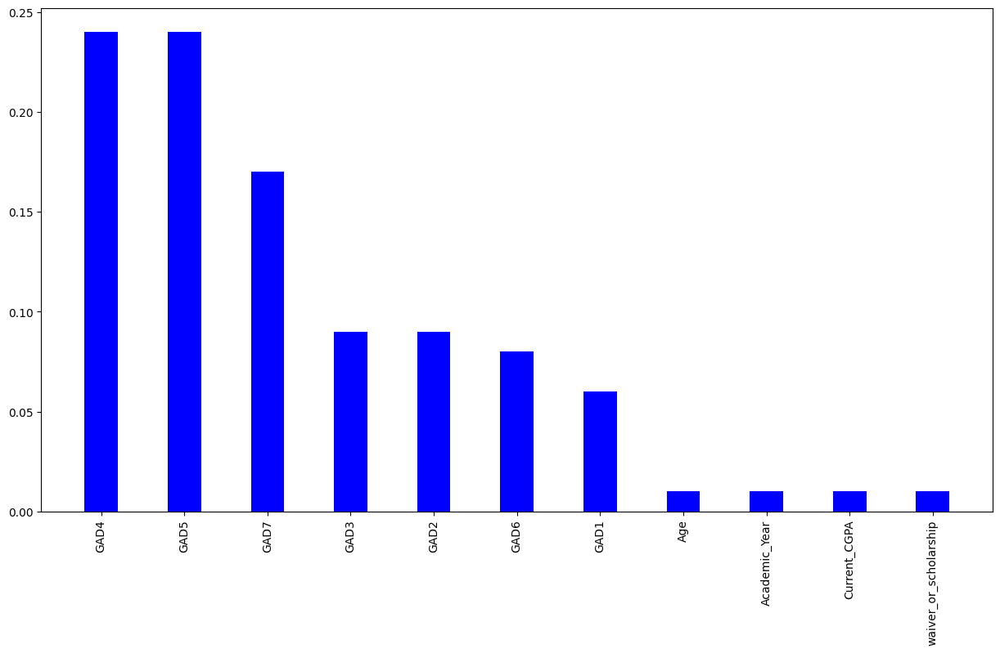

In [ ]:
# PLotting features vs their importance factors
fig = plt.figure(figsize = (15, 8))

# Extracting importance values
values =check_importance(best_xgb, X_train)[check_importance(best_xgb, X_train)['Feature Importance']>0]['Feature Importance'].values


# Extracting importance features
features = check_importance(best_xgb, X_train)[check_importance(best_xgb, X_train)['Feature Importance']>0]['Feature'].values

plt.bar(features, values, color ='blue',width = 0.4)
plt.xticks( rotation='vertical')
plt.show()

In [ ]:
# Interpretting the model using lime
interpret_with_lime(best_xgb,X_test)

# **Logistic Regression**

In [ ]:
# Parameter grid for Logistic Regression
solvers = ['lbfgs']
penalty = ['l2']
c_values = [100, 10, 1.0, 0.1, 0.01]
lr_parameters = dict(solver=solvers,penalty=penalty,C=c_values)# define grid search
lg = LogisticRegression( max_iter=5000)

#lr_optimal_model = grid_search(LogisticRegression( max_iter=5000), lr_parameters, X_train, Y_train)

# Grid search with cross-validation
grid_search = GridSearchCV(estimator=lg, param_grid=lr_parameters, cv=5)

# You can fit your data to the grid search object like this:
grid_search.fit(X_train,Y_train)

# After fitting, you can access the best parameters using:
grid_search.best_params_

{'C': 10, 'penalty': 'l2', 'solver': 'lbfgs'}

In [ ]:
best_lg = LogisticRegression( max_iter=500, C = 10, penalty = 'l2', solver = 'lbfgs')
# You can now train your model using the best parameters
best_lg.fit(X_train, Y_train)

# Once trained, you can use the model for predictions
x_pred = best_lg.predict(X_train)
y_pred = best_lg.predict(X_test)

In [ ]:
# Calculating accuracy on train and test
train_accuracy = accuracy_score(Y_train,x_pred)
test_accuracy = accuracy_score(Y_test,y_pred)


print("Train Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)

Train Accuracy: 0.9916812609457093
Test Accuracy: 0.986013986013986


In [ ]:
# Calculate precision, recall, and F1-score
precision = precision_score(Y_test,y_pred, average='weighted')
recall = recall_score(Y_test,y_pred, average='weighted')
f1 = f1_score(Y_test,y_pred, average='weighted')

print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)


acc.append(test_accuracy)
pre.append(precision)
rec.append(recall)
score.append(f1)
ml_model.append('Logistic Regression')

Precision: 0.9862625119978061
Recall: 0.986013986013986
F1-score: 0.9860627999357031


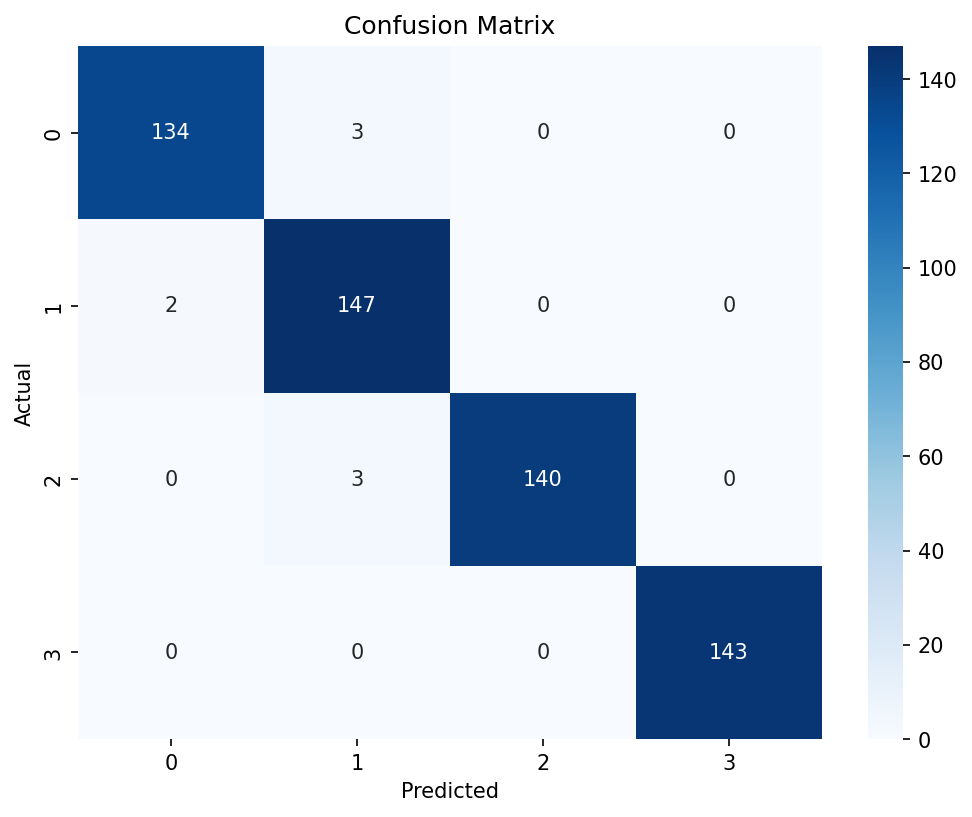

In [ ]:
conf_matrix = confusion_matrix(Y_test,y_pred)


plt.figure(figsize=(8, 6),dpi = 150)
sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

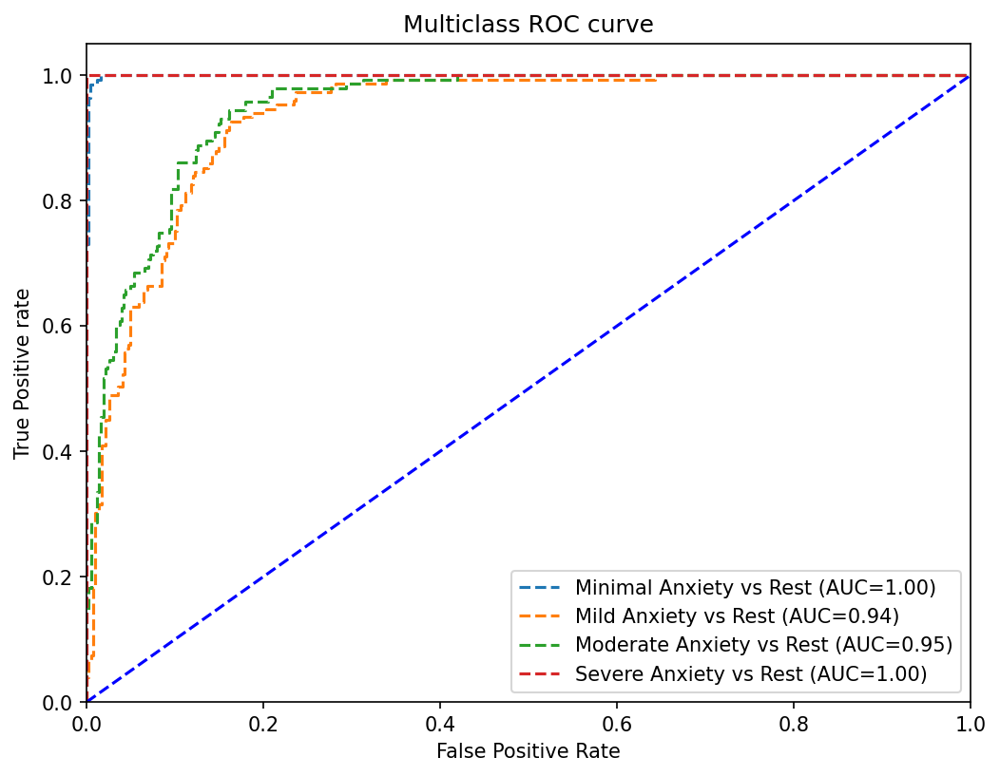

In [ ]:
plt.figure(figsize=(8, 6),dpi=150)
n_classes = classes.shape[0]
# Train classifier
classifier = OneVsRestClassifier(best_lg)
classifier.fit(X_train, Y_train)
y_score = classifier.predict_proba(X_test)

y_test_binarized=label_binarize(Y_test,classes=np.unique(Y_test))

# roc curve for classes
fpr = {}
tpr = {}
thresh ={}
roc_auc = dict()


for i in range(n_classes):
    fpr[i], tpr[i], thresh[i] = roc_curve(y_test_binarized[:,i], y_score[:,i])
    roc_auc[i] = auc(fpr[i], tpr[i])

    # plotting
    plt.plot(fpr[i], tpr[i], linestyle='--',
             label='%s vs Rest (AUC=%0.2f)'%(classes[i],roc_auc[i]))


plt.plot([0,1],[0,1],'b--')
plt.xlim([0,1])
plt.ylim([0,1.05])
plt.title('Multiclass ROC curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive rate')
plt.legend(loc='lower right')
plt.show()

In [ ]:
import pandas as pd

# Assuming best_lg is your trained logistic regression model
# Assuming X_train is your training data with column names
coefficients = pd.DataFrame({'Feature': X_train.columns, 'Coefficient': best_lg.coef_[0]})
coefficients = coefficients.sort_values(by='Coefficient', ascending=False)

print(coefficients)

                  Feature  Coefficient
0                     Age     0.686277
1                  Gender     0.462685
2           Academic_Year    -0.125051
3            Current_CGPA    -0.198344
4   waiver_or_scholarship    -0.398633
11                   GAD7    -6.065293
8                    GAD4    -6.158924
9                    GAD5    -6.201086
7                    GAD3    -6.209901
5                    GAD1    -6.412457
6                    GAD2    -6.510060
10                   GAD6    -6.822215


In [ ]:
# Interpretting the model using lime
interpret_with_lime(best_lg,X_test)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


# **SVM**

In [ ]:
from sklearn.svm import SVC
param_grid = {
    'C': [0.1, 1, 10],
    'kernel': ['linear', 'rbf', 'poly'],
    'gamma': ['scale', 'auto']
}

svm_classifier = SVC()

# Perform GridSearchCV
grid_search = GridSearchCV(estimator=svm_classifier, param_grid=param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, Y_train)

# Get the best parameters
grid_search.best_params_

{'C': 1, 'gamma': 'scale', 'kernel': 'linear'}

In [ ]:
best_svm = SVC( C=1, kernel='linear',gamma= 'scale',probability=True)
# You can now train your model using the best parameters
best_svm.fit(X_train, Y_train)

# Once trained, you can use the model for predictions
x_pred = best_svm.predict(X_train)
y_pred = best_svm.predict(X_test)

In [ ]:
# Calculating accuracy on train and test
train_accuracy = accuracy_score(Y_train,x_pred)
test_accuracy = accuracy_score(Y_test,y_pred)
print("Train Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)

Train Accuracy: 0.9916812609457093
Test Accuracy: 0.9912587412587412


In [ ]:
# Calculate precision, recall, and F1-score
precision = precision_score(Y_test,y_pred, average='weighted')
recall = recall_score(Y_test,y_pred, average='weighted')
f1 = f1_score(Y_test,y_pred, average='weighted')

print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)


acc.append(test_accuracy)
pre.append(precision)
rec.append(recall)
score.append(f1)
ml_model.append('SVM')

Precision: 0.9913440156965336
Recall: 0.9912587412587412
F1-score: 0.9912582281831367


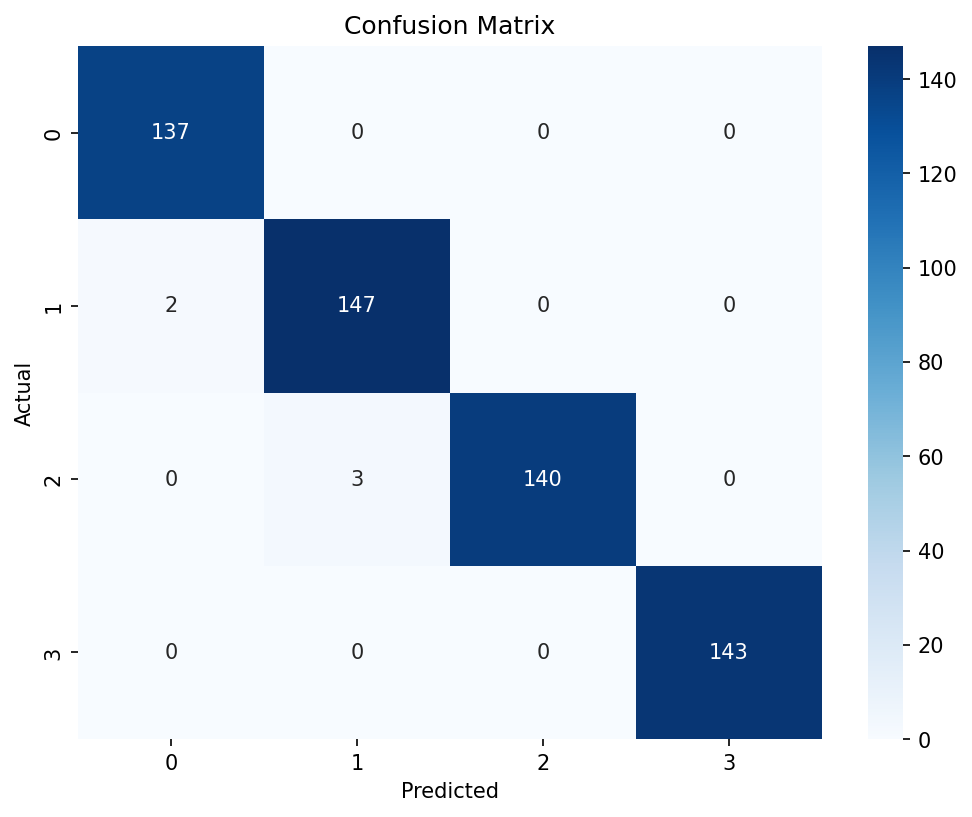

In [ ]:
conf_matrix = confusion_matrix(Y_test,y_pred)


plt.figure(figsize=(8, 6),dpi = 150)
sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

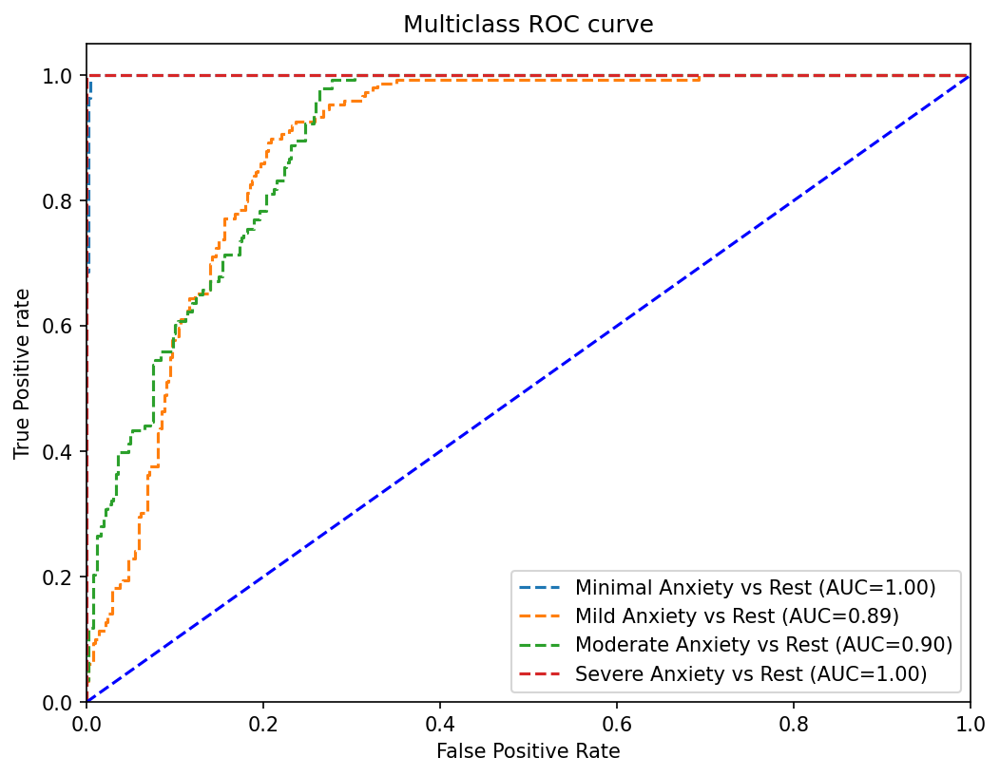

In [ ]:
plt.figure(figsize=(8, 6),dpi=150)
n_classes = classes.shape[0]
# Train classifier
classifier = OneVsRestClassifier(best_svm)
classifier.fit(X_train, Y_train)
y_score = classifier.predict_proba(X_test)

y_test_binarized=label_binarize(Y_test,classes=np.unique(Y_test))

# roc curve for classes
fpr = {}
tpr = {}
thresh ={}
roc_auc = dict()


for i in range(n_classes):
    fpr[i], tpr[i], thresh[i] = roc_curve(y_test_binarized[:,i], y_score[:,i])
    roc_auc[i] = auc(fpr[i], tpr[i])

    # plotting
    plt.plot(fpr[i], tpr[i], linestyle='--',
             label='%s vs Rest (AUC=%0.2f)'%(classes[i],roc_auc[i]))


plt.plot([0,1],[0,1],'b--')
plt.xlim([0,1])
plt.ylim([0,1.05])
plt.title('Multiclass ROC curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive rate')
plt.legend(loc='lower right')
plt.show()

In [ ]:
# Interpretting the model using lime
interpret_with_lime(best_svm,X_test)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(


# **KNN**

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
# Create KNN classifier
knn_classifier = KNeighborsClassifier()

# Define the parameter grid
param_grid = {
    'n_neighbors': [3, 5, 7, 9],  # Number of neighbors to consider
    'weights': ['uniform', 'distance'],  # Weight function used in prediction
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],  # Algorithm used to compute nearest neighbors
    'p': [1, 2]  # Power parameter for Minkowski distance
}

# Perform grid search cross-validation
grid_search = GridSearchCV(estimator=knn_classifier, param_grid=param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, Y_train)

# Get the best parameters
grid_search.best_params_

{'algorithm': 'brute', 'n_neighbors': 7, 'p': 2, 'weights': 'distance'}

In [ ]:
best_knn =  KNeighborsClassifier(algorithm='brute', n_neighbors=7, p=2, weights= 'distance')
# You can now train your model using the best parameters
best_knn.fit(X_train, Y_train)

# Once trained, you can use the model for predictions
x_pred = best_knn.predict(X_train)
y_pred = best_knn.predict(X_test)

In [ ]:
# Calculating accuracy on train and test
train_accuracy = accuracy_score(Y_train,x_pred)
test_accuracy = accuracy_score(Y_test,y_pred)
print("Train Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)

Train Accuracy: 1.0
Test Accuracy: 0.9335664335664335


In [ ]:
# Calculate precision, recall, and F1-score
precision = precision_score(Y_test,y_pred, average='weighted')
recall = recall_score(Y_test,y_pred, average='weighted')
f1 = f1_score(Y_test,y_pred, average='weighted')

print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)


acc.append(test_accuracy)
pre.append(precision)
rec.append(recall)
score.append(f1)
ml_model.append('KNN')

Precision: 0.9354516383692585
Recall: 0.9335664335664335
F1-score: 0.9337430768369244


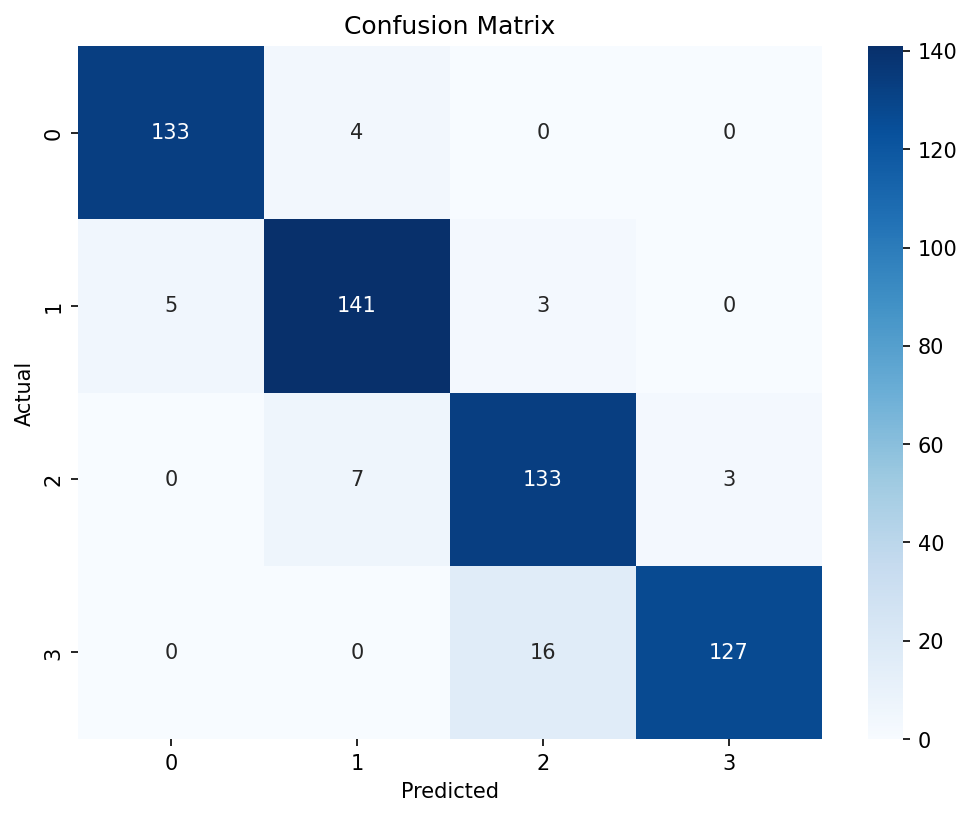

In [ ]:
conf_matrix = confusion_matrix(Y_test,y_pred)


plt.figure(figsize=(8, 6),dpi = 150)
sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

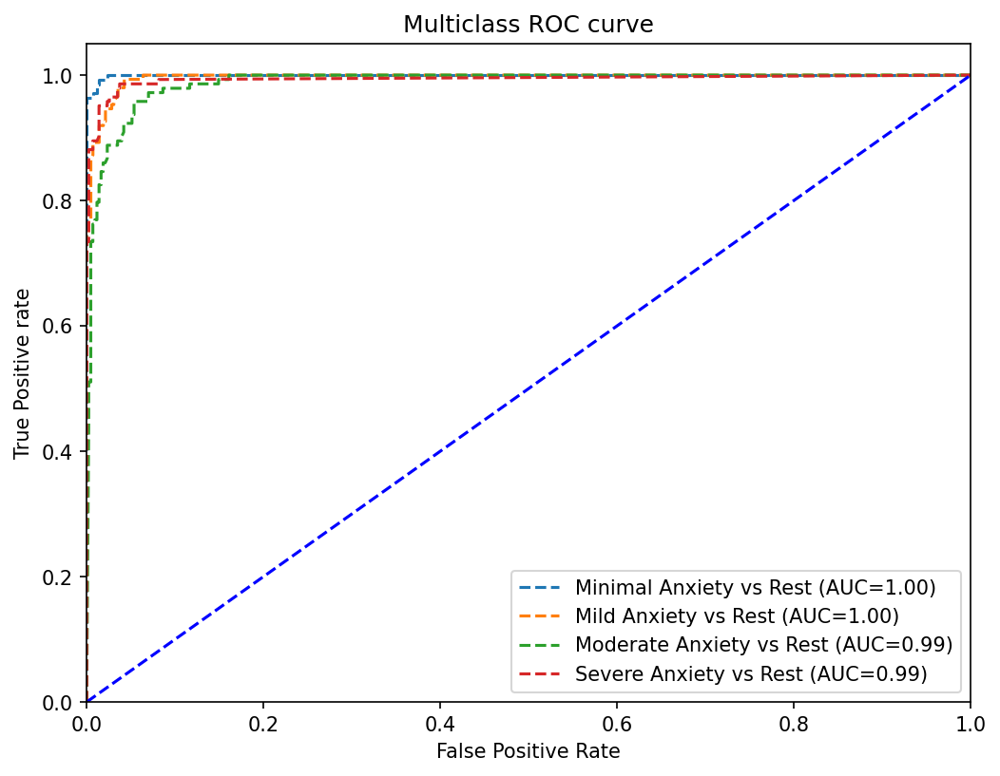

In [ ]:
plt.figure(figsize=(8, 6),dpi=150)
n_classes = classes.shape[0]
# Train classifier
classifier = OneVsRestClassifier(best_knn)
classifier.fit(X_train, Y_train)
y_score = classifier.predict_proba(X_test)

y_test_binarized=label_binarize(Y_test,classes=np.unique(Y_test))

# roc curve for classes
fpr = {}
tpr = {}
thresh ={}
roc_auc = dict()


for i in range(n_classes):
    fpr[i], tpr[i], thresh[i] = roc_curve(y_test_binarized[:,i], y_score[:,i])
    roc_auc[i] = auc(fpr[i], tpr[i])

    # plotting
    plt.plot(fpr[i], tpr[i], linestyle='--',
             label='%s vs Rest (AUC=%0.2f)'%(classes[i],roc_auc[i]))


plt.plot([0,1],[0,1],'b--')
plt.xlim([0,1])
plt.ylim([0,1.05])
plt.title('Multiclass ROC curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive rate')
plt.legend(loc='lower right')
plt.show()

In [ ]:
# Interpretting the model using lime
interpret_with_lime(best_knn,X_test)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(


In [ ]:
print(acc)
print(pre)
print(rec)
print(score)
print(ml_model)

[0.9178321678321678, 0.9038461538461539, 0.9737762237762237, 0.9562937062937062, 0.986013986013986, 0.9912587412587412, 0.9335664335664335]
[0.917884962553502, 0.9058498337997881, 0.9736906860847384, 0.9563545567330702, 0.9862625119978061, 0.9913440156965336, 0.9354516383692585]
[0.9178321678321678, 0.9038461538461539, 0.9737762237762237, 0.9562937062937062, 0.986013986013986, 0.9912587412587412, 0.9335664335664335]
[0.9177849129995348, 0.9044655751294672, 0.9737041865032016, 0.9562955660809787, 0.9860627999357031, 0.9912582281831367, 0.9337430768369244]
['Decision Tree', 'Random Forest', 'Gradient Boosting', 'XGBoost', 'Logistic Regression', 'SVM', 'KNN']


In [ ]:
acc1 = [round(val, 4)*100 for val in acc]
pre1 = [round(val, 4)*100 for val in pre]
rec1 = [round(val, 4)*100 for val in rec]
score1 = [round(val, 4)*100 for val in score]

In [ ]:
print(acc1)
print(pre1)
print(rec1)
print(score1)
print(ml_model)

[91.78, 90.38000000000001, 97.38, 95.63000000000001, 98.6, 99.13, 93.36]
[91.79, 90.58, 97.37, 95.64, 98.63, 99.13, 93.55]
[91.78, 90.38000000000001, 97.38, 95.63000000000001, 98.6, 99.13, 93.36]
[91.78, 90.45, 97.37, 95.63000000000001, 98.61, 99.13, 93.37]
['Decision Tree', 'Random Forest', 'Gradient Boosting', 'XGBoost', 'Logistic Regression', 'SVM', 'KNN']


In [ ]:
# Assuming acc, pre, rec, and score are your lists containing the values
data = {
    'Model': ml_model,
    'Accuracy': acc1,
    'Precision': pre1,
    'Recall': rec1,
    'Score': score1
}

# Create a DataFrame
res = pd.DataFrame(data)

# Print the DataFrame
res

,Model,Accuracy,Precision,Recall,Score
0,Decision Tree,91.78,91.79,91.78,91.78
1,Random Forest,90.38,90.58,90.38,90.45
2,Gradient Boosting,97.38,97.37,97.38,97.37
3,XGBoost,95.63,95.64,95.63,95.63
4,Logistic Regression,98.60,98.63,98.60,98.61
5,SVM,99.13,99.13,99.13,99.13
6,KNN,93.36,93.55,93.36,93.37


In [ ]:
res_sorted = res.sort_values(by='Accuracy',ascending=False)
res_sorted

,Model,Accuracy,Precision,Recall,Score
5,SVM,99.13,99.13,99.13,99.13
4,Logistic Regression,98.60,98.63,98.60,98.61
2,Gradient Boosting,97.38,97.37,97.38,97.37
3,XGBoost,95.63,95.64,95.63,95.63
6,KNN,93.36,93.55,93.36,93.37
0,Decision Tree,91.78,91.79,91.78,91.78
1,Random Forest,90.38,90.58,90.38,90.45


# **Deep Learning**

In [ ]:
from keras.models import Sequential
from keras.layers import Dense, LSTM, Dropout, GRU, Bidirectional
from tensorflow.keras.optimizers import SGD
import math
from tqdm.auto import tqdm



import random, os, sys
import numpy as np
from keras.models import *
from keras.layers import *
from keras.callbacks import *
from keras.initializers import *
import tensorflow as tf
from tensorflow.keras.layers import Layer

In [ ]:
dl_acc = []
dl_pr = []
dl_re = []
dl_f1 = []
dl_model = []

# **Long short-term memory (LSTM)**

In [ ]:
from keras.utils import to_categorical
# The LSTM architecture
lstm = Sequential()
# First LSTM layer with Dropout regularisation
lstm.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1],1)))
lstm.add(Dropout(0.2))
# Second LSTM layer
lstm.add(LSTM(units=50, return_sequences=True))
lstm.add(Dropout(0.2))
# Third LSTM layer
# lstm.add(LSTM(units=50, return_sequences=True))
# lstm.add(Dropout(0.5))
# Fourth LSTM layer
lstm.add(LSTM(units=50))
lstm.add(Dropout(0.5))
# The output layer
lstm.add(Dense(units=4, activation='softmax'))

# Compiling the RNN
lstm.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

y_train_encoded = to_categorical(Y_train, num_classes=4)
y_test_encoded = to_categorical(Y_test, num_classes=4)
# Fitting to the training set

history = lstm.fit(X_train,y_train_encoded, epochs=100, batch_size=32, validation_data=(X_test, y_test_encoded))

Epoch 1/100
72/72 [==============================] - 9s 32ms/step - loss: 0.9971 - accuracy: 0.5447 - val_loss: 0.4713 - val_accuracy: 0.8269
Epoch 2/100
72/72 [==============================] - 1s 12ms/step - loss: 0.3796 - accuracy: 0.8564 - val_loss: 0.4288 - val_accuracy: 0.8217
Epoch 3/100
72/72 [==============================] - 1s 13ms/step - loss: 0.2828 - accuracy: 0.8897 - val_loss: 0.1714 - val_accuracy: 0.9388
Epoch 4/100
72/72 [==============================] - 1s 12ms/step - loss: 0.2375 - accuracy: 0.9054 - val_loss: 0.1792 - val_accuracy: 0.9406
Epoch 5/100
72/72 [==============================] - 1s 9ms/step - loss: 0.2409 - accuracy: 0.9015 - val_loss: 0.1567 - val_accuracy: 0.9406
Epoch 6/100
72/72 [==============================] - 1s 9ms/step - loss: 0.2109 - accuracy: 0.9168 - val_loss: 0.1455 - val_accuracy: 0.9545
Epoch 7/100
72/72 [==============================] - 1s 9ms/step - loss: 0.1939 - accuracy: 0.9186 - val_loss: 0.1964 - val_accuracy: 0.9283
Epoch 8/1

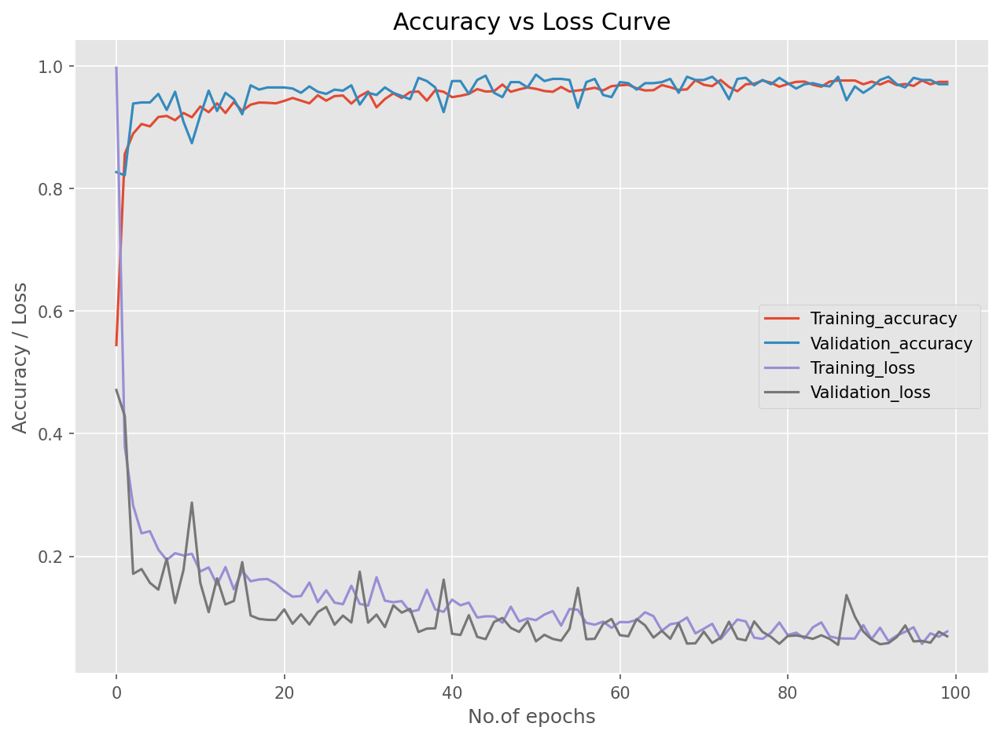

In [ ]:
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
plt.style.use('ggplot')
figure(figsize=(10, 7), dpi=150)
# plt.plot([1, 0], [0, 1], 'k--')
plt.plot(history.history['accuracy'],label='Training_accuracy')
plt.plot(history.history['val_accuracy'],label='Validation_accuracy')
plt.plot(history.history['loss'],label='Training_loss')
plt.plot(history.history['val_loss'],label='Validation_loss')
plt.legend()
plt.title('Accuracy vs Loss Curve')
plt.xlabel('No.of epochs')
plt.ylabel('Accuracy / Loss')
plt.show()

In [ ]:
y_pred=lstm.predict(X_test)
loss, accuracy = lstm.evaluate(X_test, y_test_encoded)
print("\n")
print(" Test Evaluations Scores: ","loss: ", loss," accuracy: ",accuracy)
print("\n")

# Calculate precision, recall, and F1-score
precision = precision_score(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1), average='weighted')
recall = recall_score(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1), average='weighted')
f1 = f1_score(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1), average='weighted')

print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)

score.append(f1)
dl_acc.append(accuracy)
dl_pr.append(precision)
dl_re.append(recall)
dl_f1.append(f1)
dl_model.append('LSTM')

18/18 [==============================] - 0s 4ms/step - loss: 0.0694 - accuracy: 0.9703


 Test Evaluations Scores:  loss:  0.0693550631403923  accuracy:  0.9702796936035156


Precision: 0.9709334724590016
Recall: 0.9702797202797203
F1-score: 0.9703872516847867


In [ ]:
print(dl_acc)
print(dl_pr)
print(dl_re)
print(dl_f1)
print(dl_model)

[0.9702796936035156]
[0.9709334724590016]
[0.9702797202797203]
[0.9703872516847867]
['LSTM']


In [ ]:
from sklearn import metrics
from sklearn.metrics import (confusion_matrix, precision_recall_curve, auc, roc_curve, recall_score,
                             classification_report, f1_score, average_precision_score, precision_recall_fscore_support)
print("classification Report")
print(classification_report(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1),digits=2))

classification Report
              precision    recall  f1-score   support

           0       0.99      0.97      0.98       137
           1       0.95      0.98      0.96       149
           2       0.95      0.97      0.96       143
           3       1.00      0.96      0.98       143

    accuracy                           0.97       572
   macro avg       0.97      0.97      0.97       572
weighted avg       0.97      0.97      0.97       572



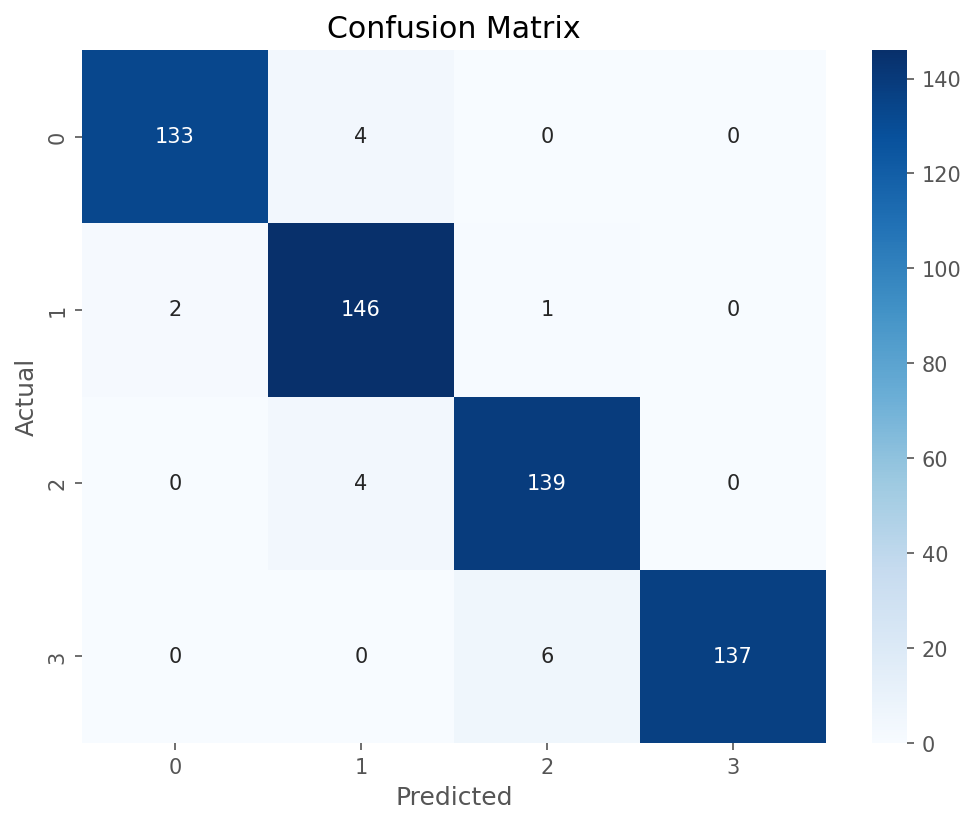

In [ ]:
cm=confusion_matrix(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1))

plt.style.use('ggplot')

plt.figure(figsize=(8, 6),dpi = 150)
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

<Figure size 640x480 with 0 Axes>

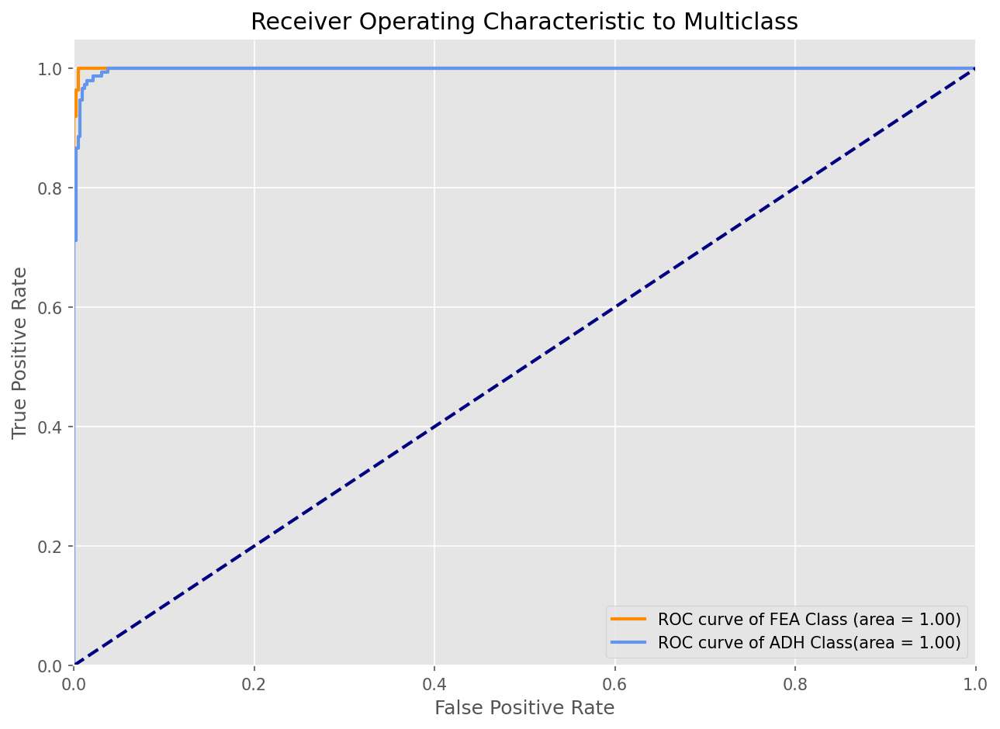

<Figure size 15000x1050 with 0 Axes>

<Figure size 640x480 with 0 Axes>

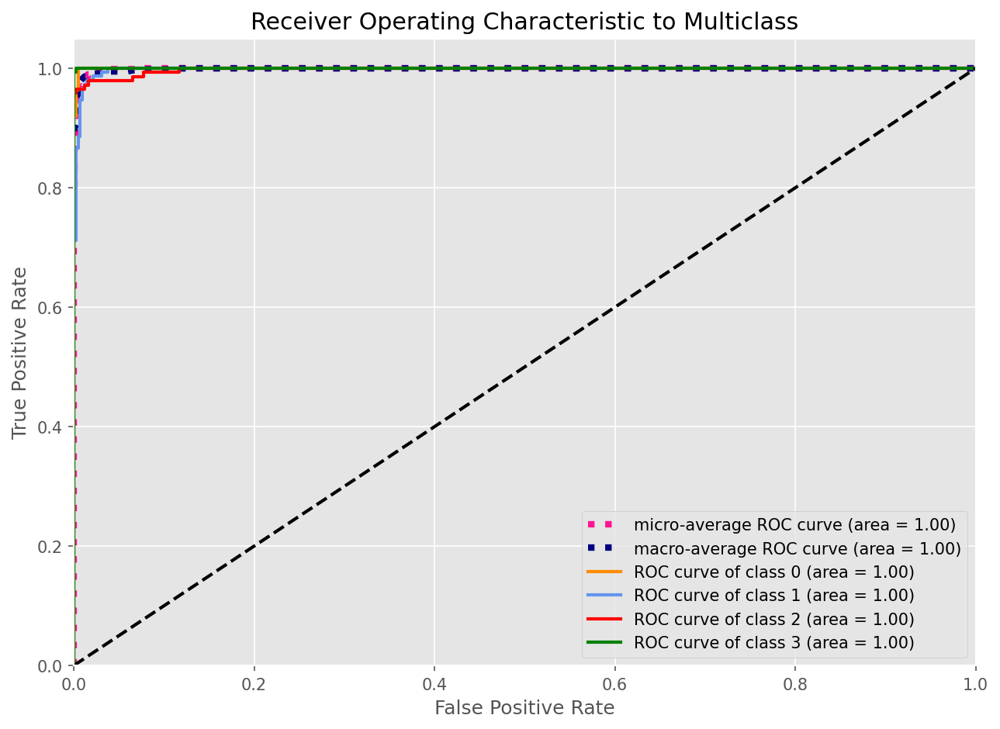

In [ ]:
 n_classes = 4 # number of class

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for c in range(n_classes):
  fpr[c], tpr[c], _ = roc_curve(y_test_encoded[:, c], y_pred[:, c], )
  roc_auc[c] = auc(fpr[c], tpr[c])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test_encoded.ravel(), y_pred.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

from matplotlib.pyplot import figure
# %% ROC Curve Plot
plt.figure()
plt.style.use('ggplot')
figure(figsize=(10, 7), dpi=150)
lw = 2 # line_width
plt.plot(fpr[0], tpr[0], color='darkorange',
                          lw=lw, label='ROC curve of FEA Class (area = %0.2f)' % roc_auc[0])

plt.plot(fpr[1], tpr[1], color='cornflowerblue',
                          lw=lw, label='ROC curve of ADH Class(area = %0.2f)' % roc_auc[1])

plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic to Multiclass')
plt.legend(loc="lower right")
plt.show()


# %% Process of plotting roc-auc curve belonging to all classes.
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
plt.style.use('ggplot')
figure(figsize=(100, 7), dpi=150)
from itertools import cycle
roc_auc_scores = []
# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[d] for d in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for b in range(n_classes):
   mean_tpr += np.interp(all_fpr, fpr[b], tpr[b])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves

plt.figure()
plt.style.use('ggplot')
figure(figsize=(10, 7), dpi=150)
plt.plot(fpr["micro"], tpr["micro"],
                          label='micro-average ROC curve (area = {0:0.2f})'
                                ''.format(roc_auc["micro"]),
                          color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
                          label='macro-average ROC curve (area = {0:0.2f})'
                                ''.format(roc_auc["macro"]),
                          color='navy', linestyle=':', linewidth=4)

colors = cycle(['darkorange', 'cornflowerblue','red','green', 'purple', 'gold'])
for a, color in zip(range(n_classes), colors):
    plt.plot(fpr[a], tpr[a], color=color, lw=lw,
                              label='ROC curve of class {0} (area = {1:0.2f})'
                              ''.format(a, roc_auc[a]))
    roc_auc_scores.append(roc_auc[a])


plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic to Multiclass')
plt.legend(loc="lower right")
plt.show()

In [ ]:
import lime
from lime import lime_tabular

def interpret_with_lime(model, X_test):
    # New data
    interpretor = lime_tabular.LimeTabularExplainer(
        training_data=np.array(X_train),
        feature_names=X_train.columns,
        mode='classification')

    exp = interpretor.explain_instance(
        data_row=X_test.iloc[10],
        predict_fn=model.predict
    )

    exp.show_in_notebook(show_table=True)


In [ ]:
# Interpretting the model using lime
interpret_with_lime(lstm,X_test)

157/157 [==============================] - 1s 3ms/step


# **Artificial neural network (ANN)**

In [ ]:
ANN_model = Sequential()

# Add the input layer and the first hidden layer
ANN_model.add(Dense(units=64, activation='relu', input_shape=(X_train.shape[1],)))

# Add dropout regularization to prevent overfitting
ANN_model.add(Dropout(0.2))

# Add more hidden layers (you can customize the number of layers and units as needed)
ANN_model.add(Dense(units=64, activation='relu'))
ANN_model.add(Dropout(0.2))

ANN_model.add(Dense(units=64, activation='relu'))
ANN_model.add(Dropout(0.2))

# Add the output layer for 3-class classification with softmax activation
ANN_model.add(Dense(units=4, activation='softmax'))

# Compile the ANN model
ANN_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the ANN model
history = ANN_model.fit(X_train,y_train_encoded, epochs=100, batch_size=32, validation_data=(X_test, y_test_encoded))

Epoch 1/100
72/72 [==============================] - 2s 6ms/step - loss: 1.0408 - accuracy: 0.5162 - val_loss: 0.6502 - val_accuracy: 0.7203
Epoch 2/100
72/72 [==============================] - 0s 5ms/step - loss: 0.6572 - accuracy: 0.6935 - val_loss: 0.4911 - val_accuracy: 0.7675
Epoch 3/100
72/72 [==============================] - 0s 5ms/step - loss: 0.5324 - accuracy: 0.7465 - val_loss: 0.4273 - val_accuracy: 0.8129
Epoch 4/100
72/72 [==============================] - 0s 4ms/step - loss: 0.4841 - accuracy: 0.7820 - val_loss: 0.3997 - val_accuracy: 0.8129
Epoch 5/100
72/72 [==============================] - 0s 5ms/step - loss: 0.4387 - accuracy: 0.8021 - val_loss: 0.3376 - val_accuracy: 0.8549
Epoch 6/100
72/72 [==============================] - 0s 5ms/step - loss: 0.4053 - accuracy: 0.8292 - val_loss: 0.3242 - val_accuracy: 0.8549
Epoch 7/100
72/72 [==============================] - 0s 5ms/step - loss: 0.3810 - accuracy: 0.8314 - val_loss: 0.2749 - val_accuracy: 0.8969
Epoch 8/100
7

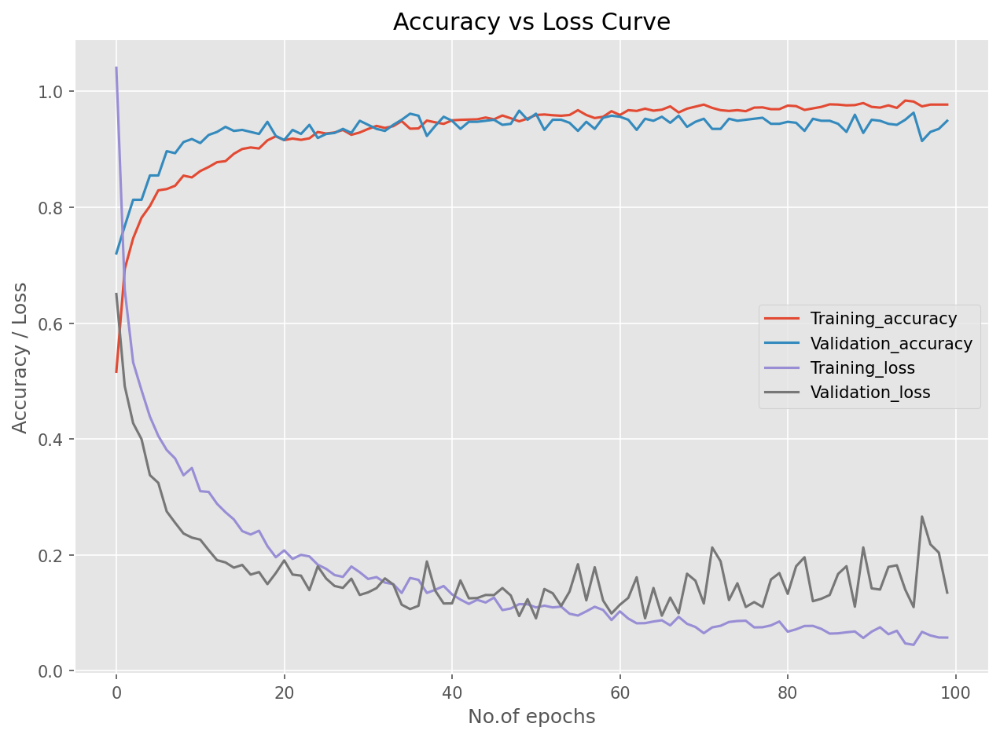

In [ ]:
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
plt.style.use('ggplot')
figure(figsize=(10, 7), dpi=150)
# plt.plot([1, 0], [0, 1], 'k--')
plt.plot(history.history['accuracy'],label='Training_accuracy')
plt.plot(history.history['val_accuracy'],label='Validation_accuracy')
plt.plot(history.history['loss'],label='Training_loss')
plt.plot(history.history['val_loss'],label='Validation_loss')
plt.legend()
plt.title('Accuracy vs Loss Curve')
plt.xlabel('No.of epochs')
plt.ylabel('Accuracy / Loss')
plt.show()

In [ ]:
y_pred=ANN_model.predict(X_test)
loss, accuracy = ANN_model.evaluate(X_test, y_test_encoded)
print("\n")
print(" Test Evaluations Scores: ","loss: ", loss," accuracy: ",accuracy)
print("\n")

# Calculate precision, recall, and F1-score
precision = precision_score(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1), average='weighted')
recall = recall_score(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1), average='weighted')
f1 = f1_score(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1), average='weighted')

print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)

score.append(f1)
dl_acc.append(accuracy)
dl_pr.append(precision)
dl_re.append(recall)
dl_f1.append(f1)
dl_model.append('ANN')

18/18 [==============================] - 0s 3ms/step - loss: 0.1349 - accuracy: 0.9493


 Test Evaluations Scores:  loss:  0.1349163055419922  accuracy:  0.9493007063865662


Precision: 0.9524568410856911
Recall: 0.9493006993006993
F1-score: 0.9495699484161753


In [ ]:
print(dl_acc)
print(dl_pr)
print(dl_re)
print(dl_f1)
print(dl_model)

[0.9702796936035156, 0.9493007063865662]
[0.9709334724590016, 0.9524568410856911]
[0.9702797202797203, 0.9493006993006993]
[0.9703872516847867, 0.9495699484161753]
['LSTM', 'ANN']


In [ ]:
print("classification Report")
print(classification_report(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1),digits=2))

classification Report
              precision    recall  f1-score   support

           0       0.99      0.96      0.97       137
           1       0.95      0.96      0.96       149
           2       0.88      0.98      0.93       143
           3       0.99      0.90      0.94       143

    accuracy                           0.95       572
   macro avg       0.95      0.95      0.95       572
weighted avg       0.95      0.95      0.95       572



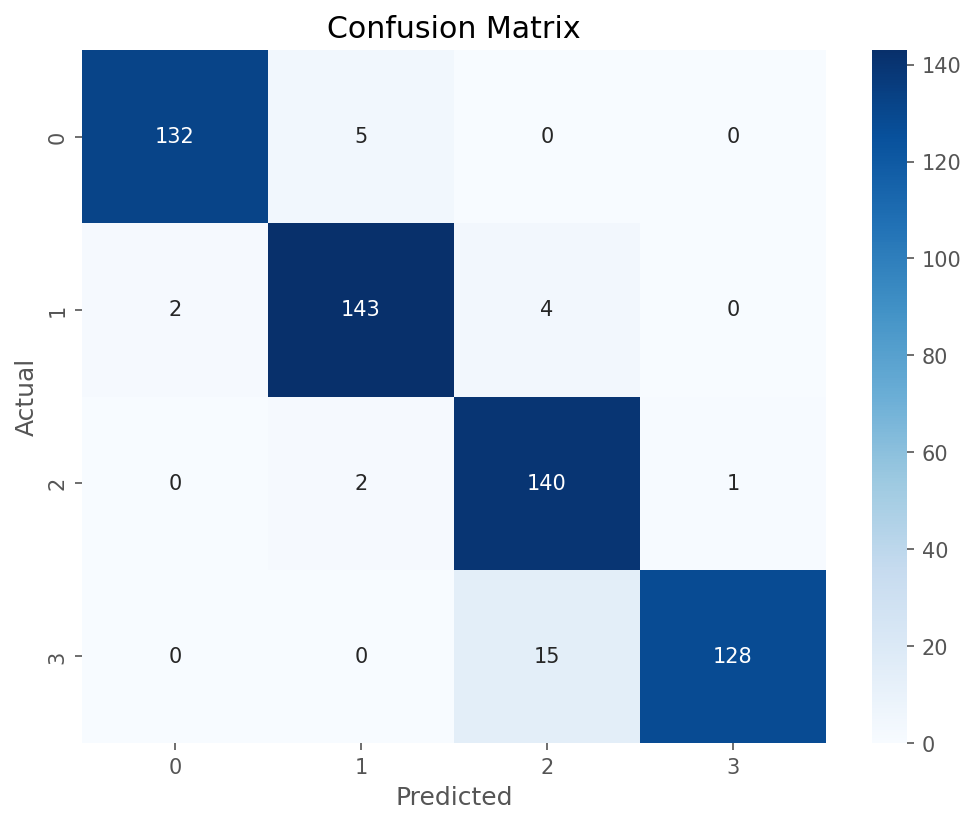

In [ ]:
cm=confusion_matrix(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1))

plt.style.use('ggplot')

plt.figure(figsize=(8, 6),dpi = 150)
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

<Figure size 640x480 with 0 Axes>

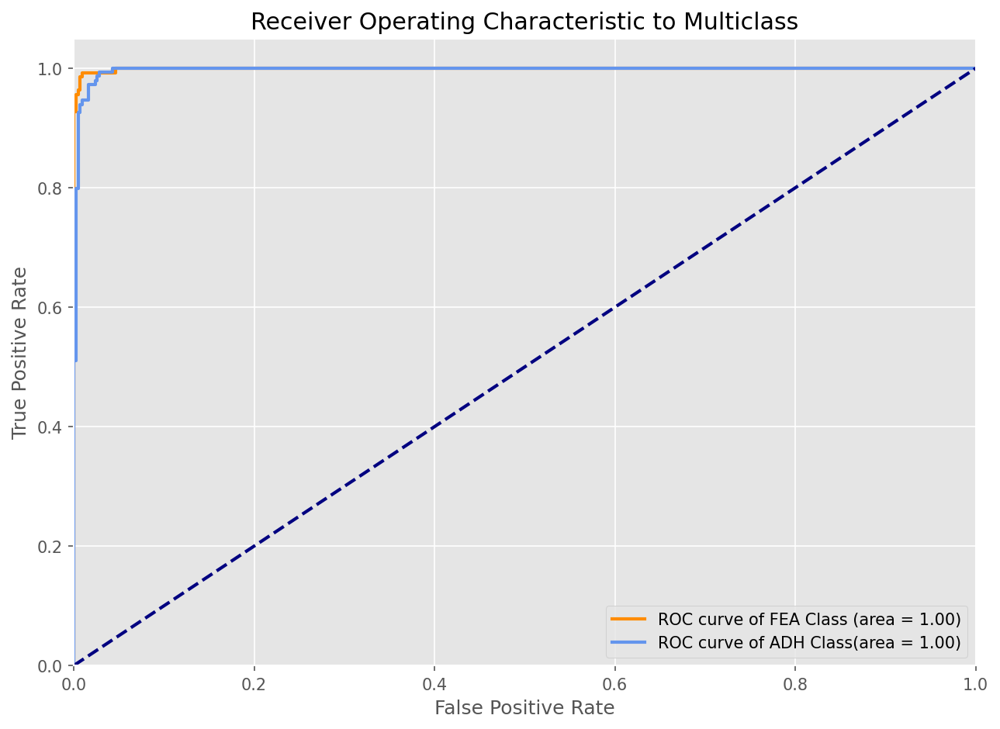

<Figure size 15000x1050 with 0 Axes>

<Figure size 640x480 with 0 Axes>

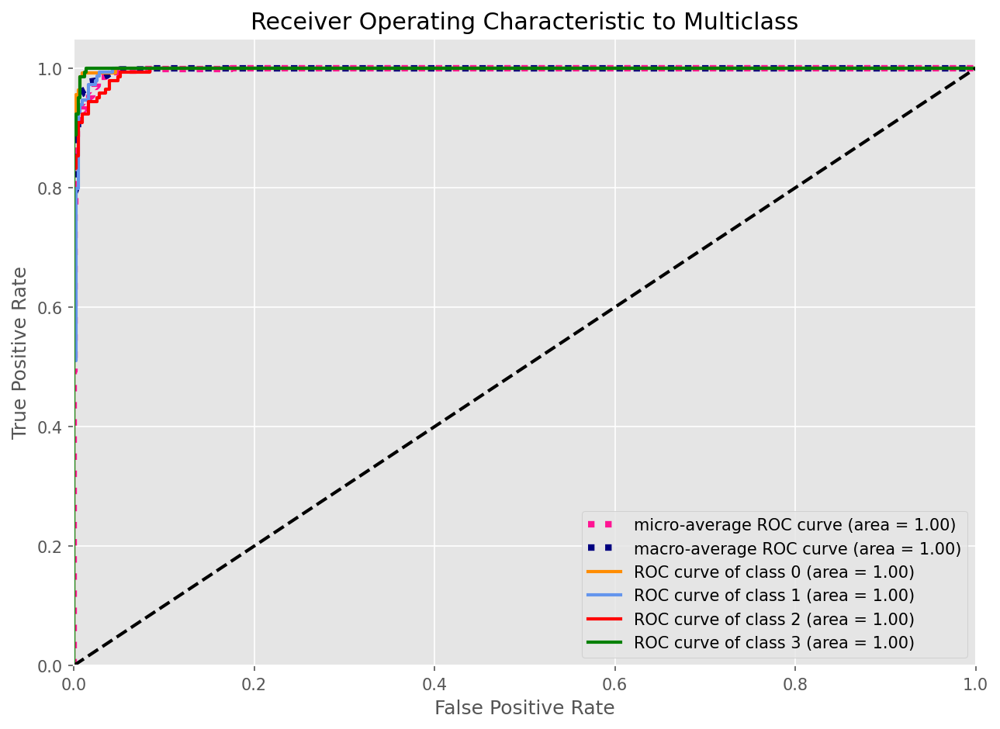

In [ ]:
#  n_classes = 4 # number of class




# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for c in range(n_classes):
  fpr[c], tpr[c], _ = roc_curve(y_test_encoded[:, c], y_pred[:, c], )
  roc_auc[c] = auc(fpr[c], tpr[c])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test_encoded.ravel(), y_pred.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

from matplotlib.pyplot import figure
# %% ROC Curve Plot
plt.figure()
plt.style.use('ggplot')
figure(figsize=(10, 7), dpi=150)
lw = 2 # line_width
plt.plot(fpr[0], tpr[0], color='darkorange',
                          lw=lw, label='ROC curve of FEA Class (area = %0.2f)' % roc_auc[0])

plt.plot(fpr[1], tpr[1], color='cornflowerblue',
                          lw=lw, label='ROC curve of ADH Class(area = %0.2f)' % roc_auc[1])

plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic to Multiclass')
plt.legend(loc="lower right")
plt.show()


# %% Process of plotting roc-auc curve belonging to all classes.
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
plt.style.use('ggplot')
figure(figsize=(100, 7), dpi=150)
from itertools import cycle
roc_auc_scores = []
# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[d] for d in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for b in range(n_classes):
   mean_tpr += np.interp(all_fpr, fpr[b], tpr[b])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves

plt.figure()
plt.style.use('ggplot')
figure(figsize=(10, 7), dpi=150)
plt.plot(fpr["micro"], tpr["micro"],
                          label='micro-average ROC curve (area = {0:0.2f})'
                                ''.format(roc_auc["micro"]),
                          color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
                          label='macro-average ROC curve (area = {0:0.2f})'
                                ''.format(roc_auc["macro"]),
                          color='navy', linestyle=':', linewidth=4)

colors = cycle(['darkorange', 'cornflowerblue','red','green', 'purple', 'gold'])
for a, color in zip(range(n_classes), colors):
    plt.plot(fpr[a], tpr[a], color=color, lw=lw,
                              label='ROC curve of class {0} (area = {1:0.2f})'
                              ''.format(a, roc_auc[a]))
    roc_auc_scores.append(roc_auc[a])


plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic to Multiclass')
plt.legend(loc="lower right")
plt.show()

In [ ]:
# Interpretting the model using lime
interpret_with_lime(ANN_model,X_test)

157/157 [==============================] - 0s 2ms/step


# **Convolutional Neural Network (CNN)**

In [ ]:
# Define and train Convolutional Neural Network (CNN)
cnn_model = Sequential([
    Reshape((X_train.shape[1], 1), input_shape=(X_train.shape[1],)),
    Conv1D(32, kernel_size=3, activation='relu'),
    Flatten(),
    Dense(64, activation='relu'),
    Dense(4, activation='softmax')
])
cnn_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
history = cnn_model.fit(X_train,y_train_encoded, epochs=100, batch_size=32, validation_data=(X_test, y_test_encoded))

Epoch 1/100
72/72 [==============================] - 3s 10ms/step - loss: 0.9017 - accuracy: 0.6081 - val_loss: 0.5722 - val_accuracy: 0.7745
Epoch 2/100
72/72 [==============================] - 0s 5ms/step - loss: 0.4438 - accuracy: 0.8275 - val_loss: 0.3995 - val_accuracy: 0.8147
Epoch 3/100
72/72 [==============================] - 0s 4ms/step - loss: 0.3115 - accuracy: 0.8897 - val_loss: 0.2693 - val_accuracy: 0.9073
Epoch 4/100
72/72 [==============================] - 0s 4ms/step - loss: 0.2327 - accuracy: 0.9199 - val_loss: 0.2140 - val_accuracy: 0.9301
Epoch 5/100
72/72 [==============================] - 0s 4ms/step - loss: 0.1877 - accuracy: 0.9330 - val_loss: 0.1855 - val_accuracy: 0.9283
Epoch 6/100
72/72 [==============================] - 0s 4ms/step - loss: 0.1555 - accuracy: 0.9448 - val_loss: 0.1388 - val_accuracy: 0.9685
Epoch 7/100
72/72 [==============================] - 0s 4ms/step - loss: 0.1324 - accuracy: 0.9619 - val_loss: 0.1272 - val_accuracy: 0.9615
Epoch 8/100


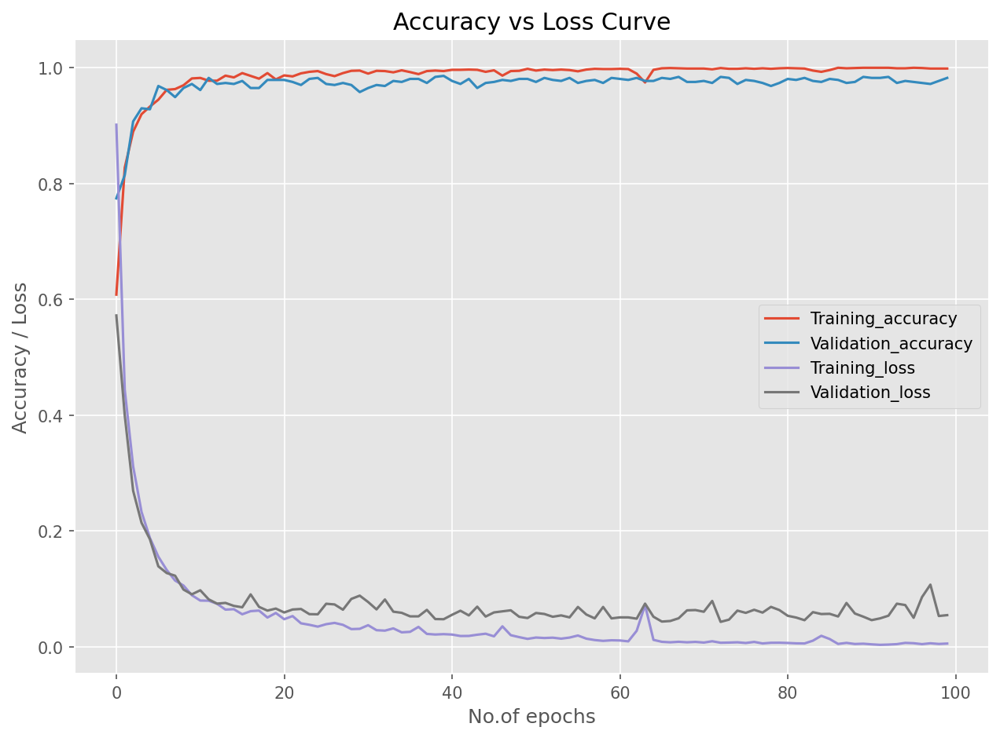

In [ ]:
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
plt.style.use('ggplot')
figure(figsize=(10, 7), dpi=150)
# plt.plot([1, 0], [0, 1], 'k--')
plt.plot(history.history['accuracy'],label='Training_accuracy')
plt.plot(history.history['val_accuracy'],label='Validation_accuracy')
plt.plot(history.history['loss'],label='Training_loss')
plt.plot(history.history['val_loss'],label='Validation_loss')
plt.legend()
plt.title('Accuracy vs Loss Curve')
plt.xlabel('No.of epochs')
plt.ylabel('Accuracy / Loss')
plt.show()

In [ ]:
y_pred=cnn_model.predict(X_test)
loss, accuracy = cnn_model.evaluate(X_test, y_test_encoded)
print("\n")
print(" Test Evaluations Scores: ","loss: ", loss," accuracy: ",accuracy)
print("\n")

# Calculate precision, recall, and F1-score
precision = precision_score(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1), average='weighted')
recall = recall_score(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1), average='weighted')
f1 = f1_score(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1), average='weighted')

print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)

score.append(f1)
dl_acc.append(accuracy)
dl_pr.append(precision)
dl_re.append(recall)
dl_f1.append(f1)
dl_model.append('CNN')

18/18 [==============================] - 0s 2ms/step - loss: 0.0545 - accuracy: 0.9825


 Test Evaluations Scores:  loss:  0.0544595904648304  accuracy:  0.9825174808502197


Precision: 0.9828507436686803
Recall: 0.9825174825174825
F1-score: 0.9825502456506625


In [ ]:
# dl_acc.pop(2)
# dl_pr.pop(2)
# dl_re.pop(2)
# dl_f1.pop(2)
# dl_model.pop(2)

In [ ]:
print(dl_acc)
print(dl_pr)
print(dl_re)
print(dl_f1)
print(dl_model)

[0.9702796936035156, 0.9493007063865662, 0.9825174808502197]
[0.9709334724590016, 0.9524568410856911, 0.9828507436686803]
[0.9702797202797203, 0.9493006993006993, 0.9825174825174825]
[0.9703872516847867, 0.9495699484161753, 0.9825502456506625]
['LSTM', 'ANN', 'CNN']


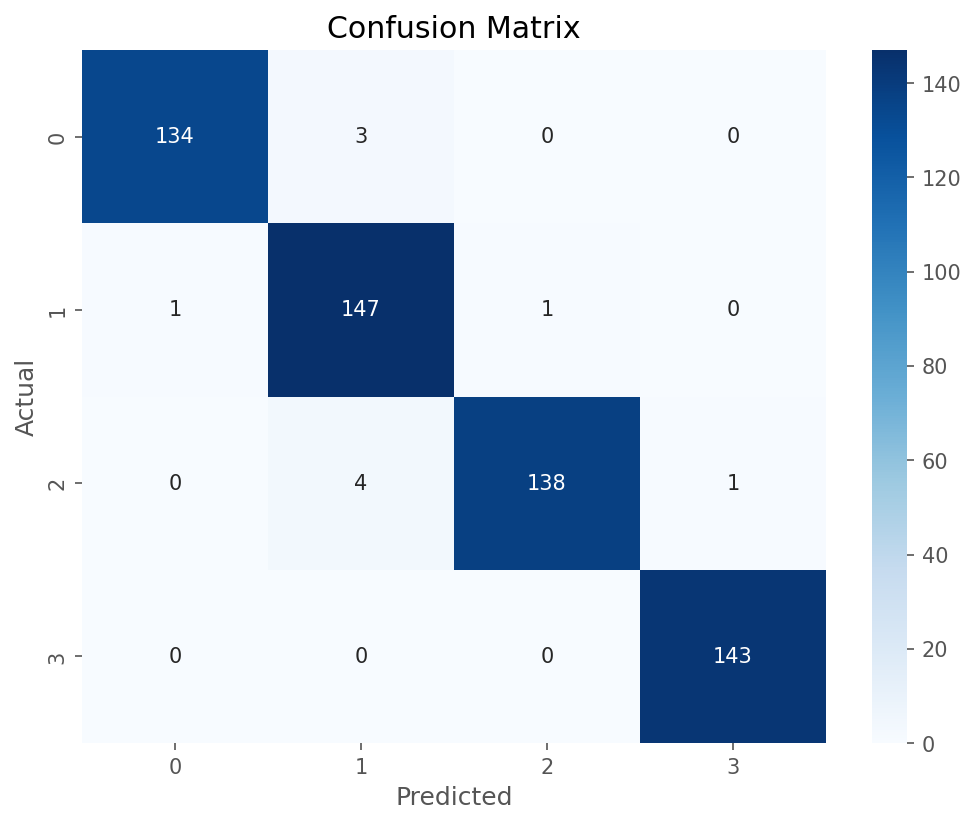

In [ ]:
cm=confusion_matrix(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1))

plt.style.use('ggplot')

plt.figure(figsize=(8, 6),dpi = 150)
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

<Figure size 640x480 with 0 Axes>

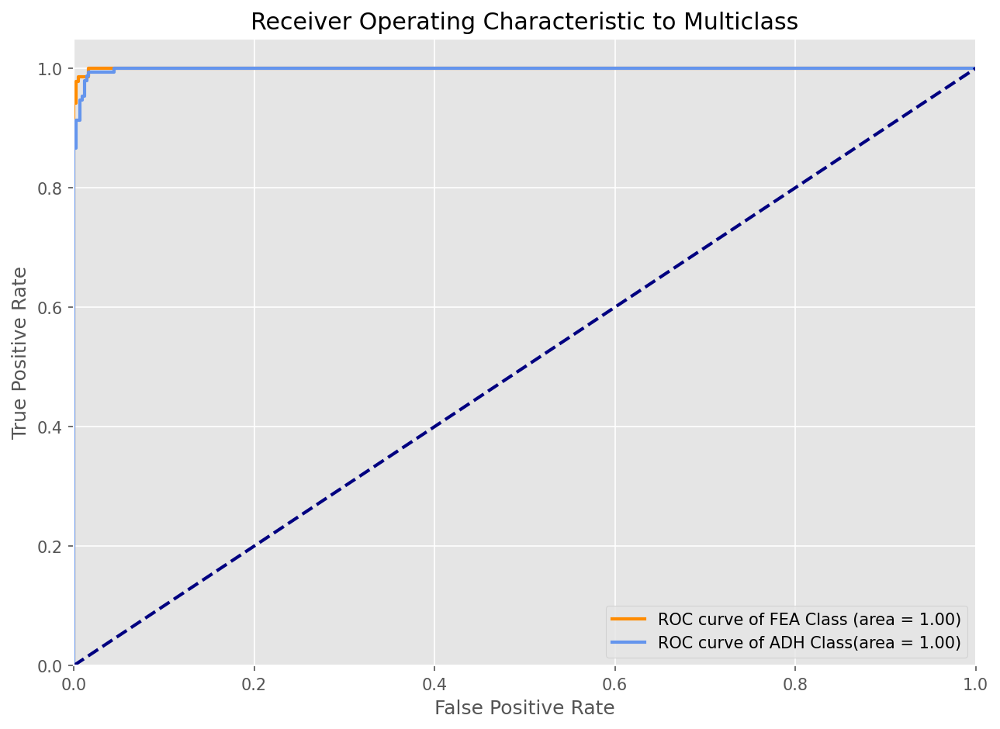

<Figure size 15000x1050 with 0 Axes>

<Figure size 640x480 with 0 Axes>

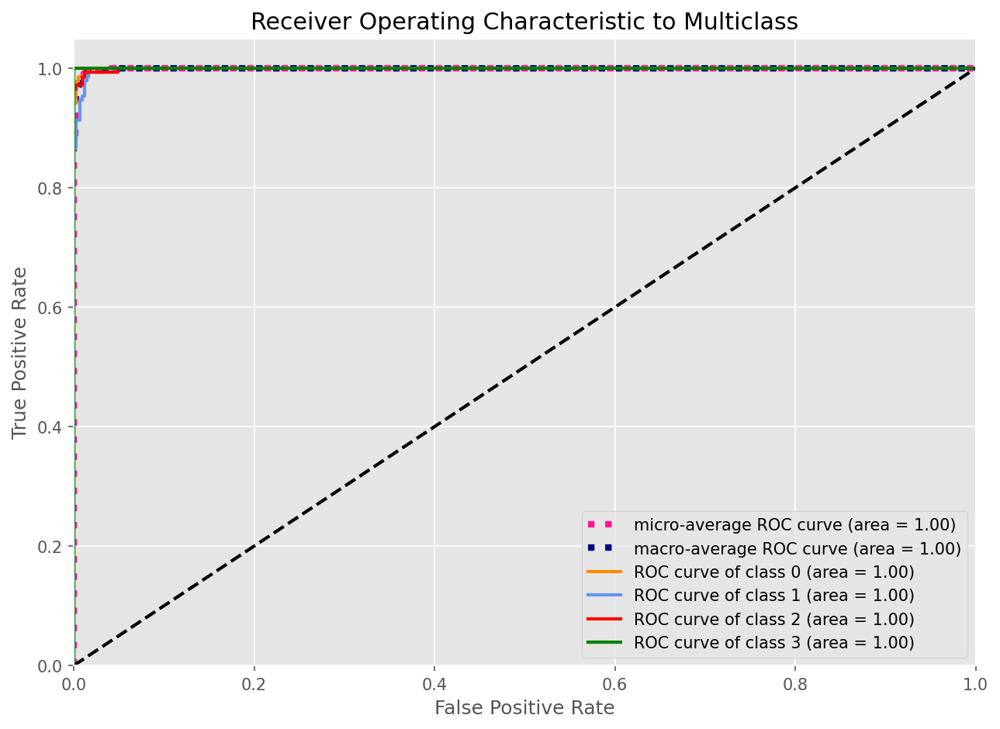

In [ ]:
#  n_classes = 3 # number of class




# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for c in range(n_classes):
  fpr[c], tpr[c], _ = roc_curve(y_test_encoded[:, c], y_pred[:, c], )
  roc_auc[c] = auc(fpr[c], tpr[c])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test_encoded.ravel(), y_pred.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

from matplotlib.pyplot import figure
# %% ROC Curve Plot
plt.figure()
plt.style.use('ggplot')
figure(figsize=(10, 7), dpi=150)
lw = 2 # line_width
plt.plot(fpr[0], tpr[0], color='darkorange',
                          lw=lw, label='ROC curve of FEA Class (area = %0.2f)' % roc_auc[0])

plt.plot(fpr[1], tpr[1], color='cornflowerblue',
                          lw=lw, label='ROC curve of ADH Class(area = %0.2f)' % roc_auc[1])

plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic to Multiclass')
plt.legend(loc="lower right")
plt.show()


# %% Process of plotting roc-auc curve belonging to all classes.
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
plt.style.use('ggplot')
figure(figsize=(100, 7), dpi=150)
from itertools import cycle
roc_auc_scores = []
# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[d] for d in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for b in range(n_classes):
   mean_tpr += np.interp(all_fpr, fpr[b], tpr[b])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves

plt.figure()
plt.style.use('ggplot')
figure(figsize=(10, 7), dpi=150)
plt.plot(fpr["micro"], tpr["micro"],
                          label='micro-average ROC curve (area = {0:0.2f})'
                                ''.format(roc_auc["micro"]),
                          color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
                          label='macro-average ROC curve (area = {0:0.2f})'
                                ''.format(roc_auc["macro"]),
                          color='navy', linestyle=':', linewidth=4)

colors = cycle(['darkorange', 'cornflowerblue','red','green', 'purple', 'gold'])
for a, color in zip(range(n_classes), colors):
    plt.plot(fpr[a], tpr[a], color=color, lw=lw,
                              label='ROC curve of class {0} (area = {1:0.2f})'
                              ''.format(a, roc_auc[a]))
    roc_auc_scores.append(roc_auc[a])


plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic to Multiclass')
plt.legend(loc="lower right")
plt.show()

In [ ]:
# Interpretting the model using lime
interpret_with_lime(cnn_model,X_test)

157/157 [==============================] - 0s 2ms/step


In [ ]:
from tensorflow.keras.layers import GRU
# Define and train Gated Recurrent Unit (GRU) Network
gru_model = Sequential([
    GRU(64, input_shape=(X_train.shape[1], 1)),
    Dense(4, activation='softmax')
])
gru_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
#gru_model.fit(X_train.reshape(-1, X_train.shape[1], 1), y_train, epochs=eepoch, batch_size=32, validation_split=0.2)
history = gru_model.fit(X_train,y_train_encoded, epochs=100, batch_size=32, validation_data=(X_test, y_test_encoded))

Epoch 1/100
72/72 [==============================] - 3s 13ms/step - loss: 1.0773 - accuracy: 0.5118 - val_loss: 0.6332 - val_accuracy: 0.8706
Epoch 2/100
72/72 [==============================] - 1s 8ms/step - loss: 0.3347 - accuracy: 0.8989 - val_loss: 0.2233 - val_accuracy: 0.9318
Epoch 3/100
72/72 [==============================] - 1s 7ms/step - loss: 0.2113 - accuracy: 0.9194 - val_loss: 0.2021 - val_accuracy: 0.9371
Epoch 4/100
72/72 [==============================] - 0s 7ms/step - loss: 0.1733 - accuracy: 0.9378 - val_loss: 0.1672 - val_accuracy: 0.9371
Epoch 5/100
72/72 [==============================] - 1s 8ms/step - loss: 0.1804 - accuracy: 0.9256 - val_loss: 0.1693 - val_accuracy: 0.9441
Epoch 6/100
72/72 [==============================] - 0s 7ms/step - loss: 0.1629 - accuracy: 0.9308 - val_loss: 0.1407 - val_accuracy: 0.9545
Epoch 7/100
72/72 [==============================] - 1s 9ms/step - loss: 0.1525 - accuracy: 0.9409 - val_loss: 0.1306 - val_accuracy: 0.9545
Epoch 8/100


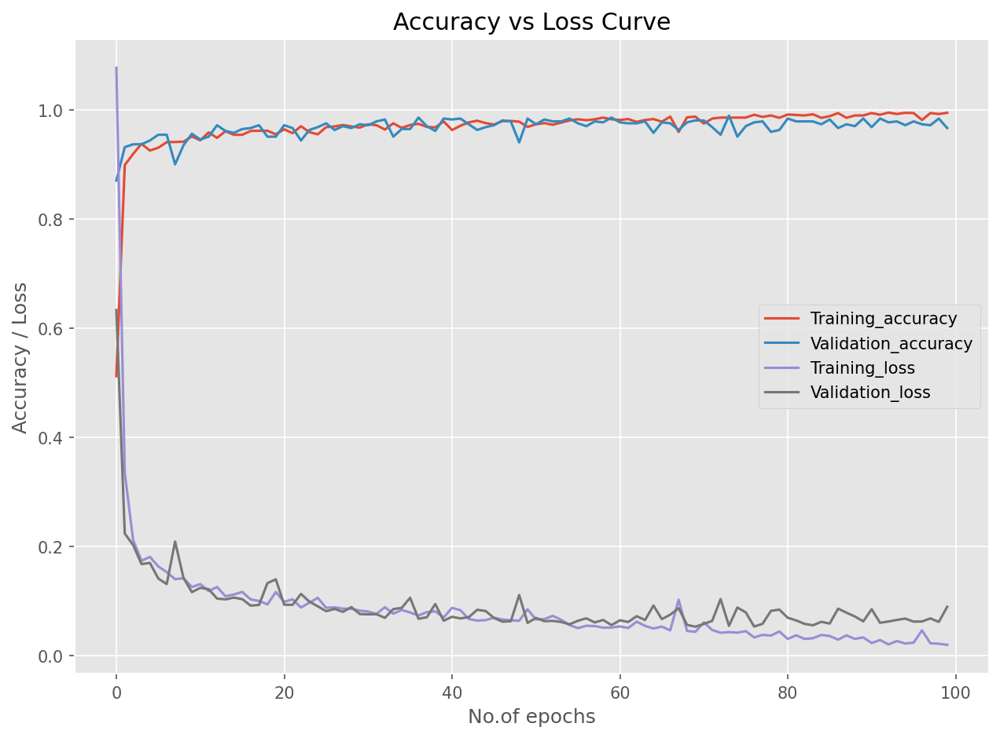

In [ ]:
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
plt.style.use('ggplot')
figure(figsize=(10, 7), dpi=150)
# plt.plot([1, 0], [0, 1], 'k--')
plt.plot(history.history['accuracy'],label='Training_accuracy')
plt.plot(history.history['val_accuracy'],label='Validation_accuracy')
plt.plot(history.history['loss'],label='Training_loss')
plt.plot(history.history['val_loss'],label='Validation_loss')
plt.legend()
plt.title('Accuracy vs Loss Curve')
plt.xlabel('No.of epochs')
plt.ylabel('Accuracy / Loss')
plt.show()

In [ ]:
y_pred=gru_model.predict(X_test)
loss, accuracy = gru_model.evaluate(X_test, y_test_encoded)
print("\n")
print(" Test Evaluations Scores: ","loss: ", loss," accuracy: ",accuracy)
print("\n")

# Calculate precision, recall, and F1-score
precision = precision_score(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1), average='weighted')
recall = recall_score(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1), average='weighted')
f1 = f1_score(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1), average='weighted')

print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)

score.append(f1)
dl_acc.append(accuracy)
dl_pr.append(precision)
dl_re.append(recall)
dl_f1.append(f1)
dl_model.append('GRU')

18/18 [==============================] - 0s 4ms/step - loss: 0.0888 - accuracy: 0.9668


 Test Evaluations Scores:  loss:  0.08880557864904404  accuracy:  0.9667832255363464


Precision: 0.9677915334078201
Recall: 0.9667832167832168
F1-score: 0.9668796063422437


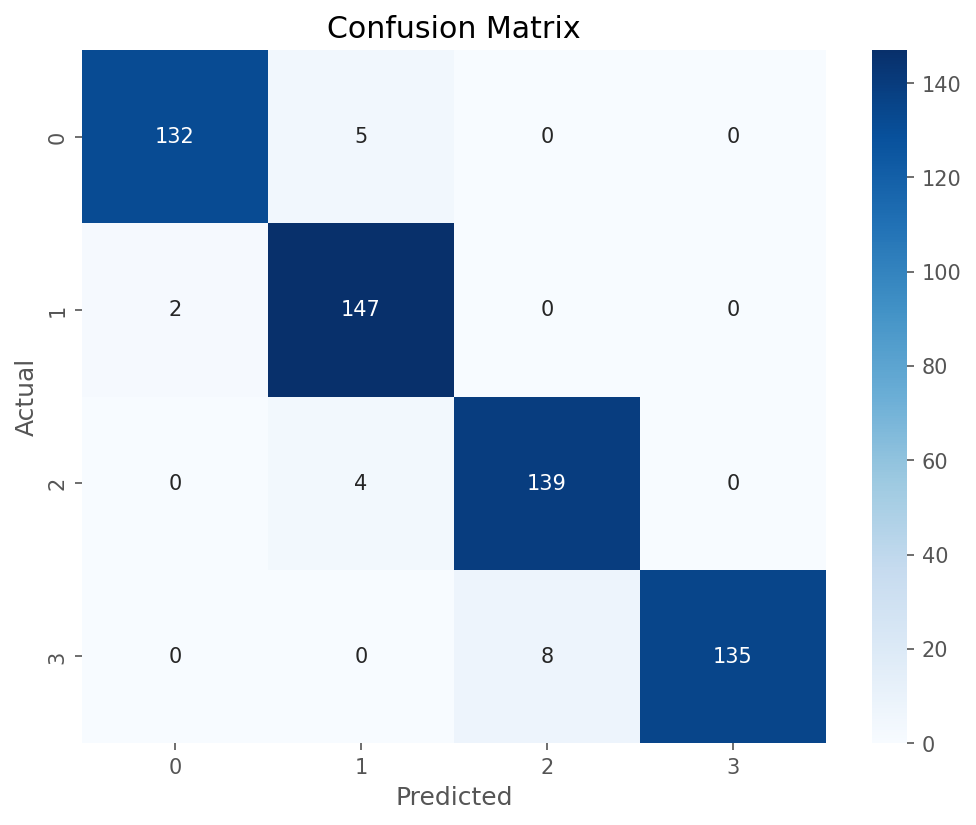

In [ ]:
cm=confusion_matrix(np.argmax(y_test_encoded, axis=1),np.argmax(y_pred, axis=1))

plt.style.use('ggplot')

plt.figure(figsize=(8, 6),dpi = 150)
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

<Figure size 640x480 with 0 Axes>

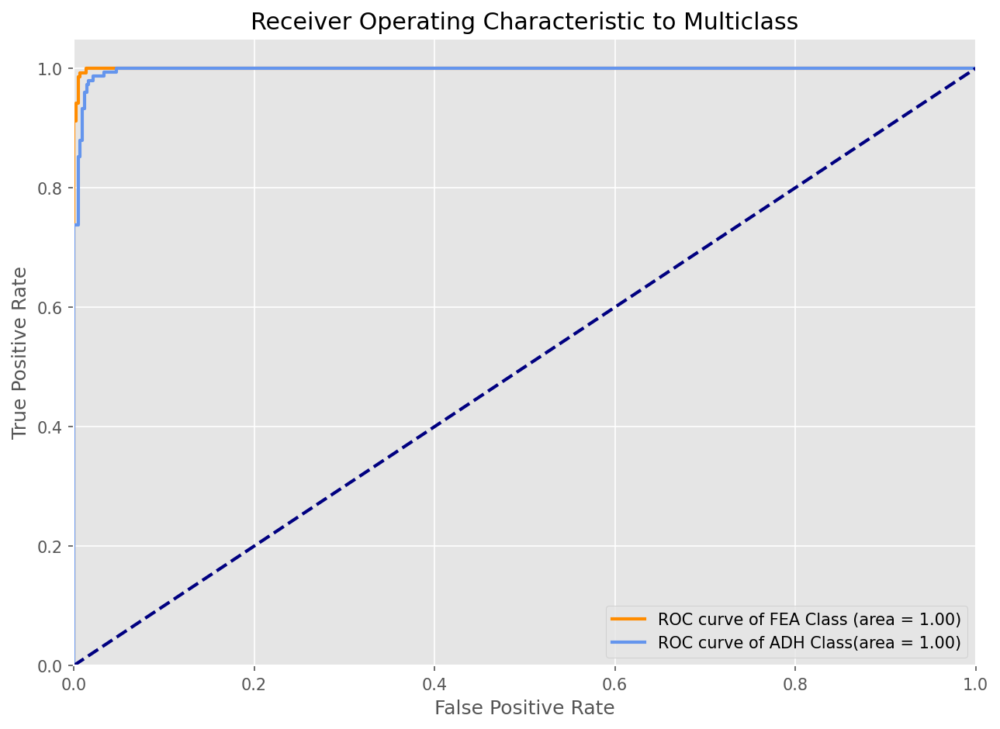

<Figure size 15000x1050 with 0 Axes>

<Figure size 640x480 with 0 Axes>

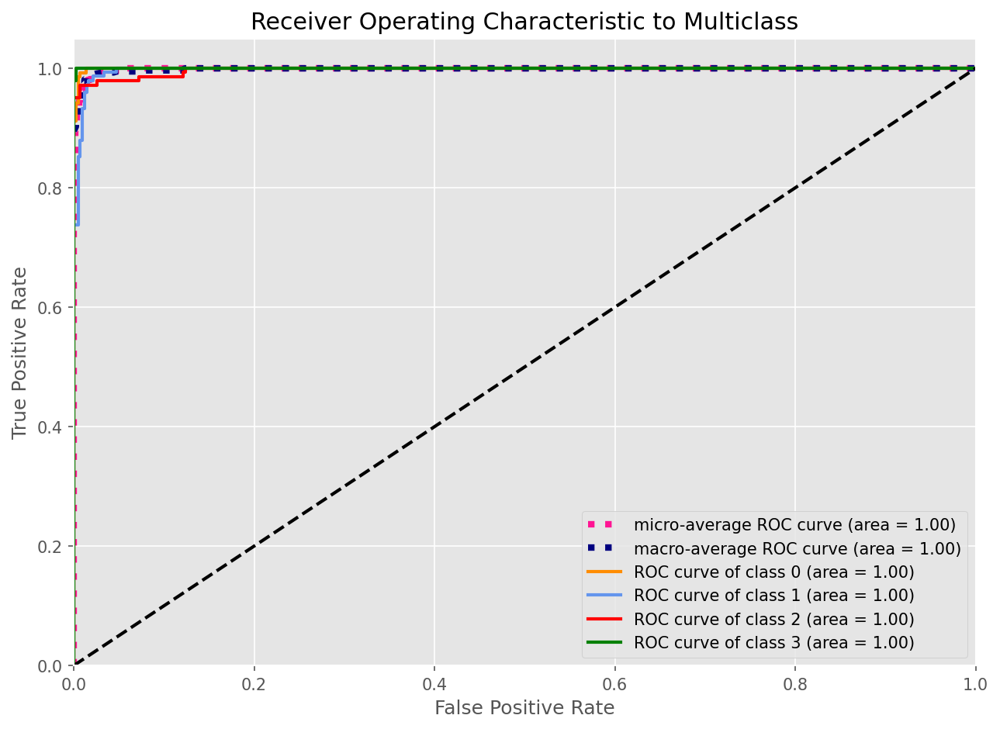

In [ ]:
#  n_classes = 3 # number of class




# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for c in range(n_classes):
  fpr[c], tpr[c], _ = roc_curve(y_test_encoded[:, c], y_pred[:, c], )
  roc_auc[c] = auc(fpr[c], tpr[c])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test_encoded.ravel(), y_pred.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

from matplotlib.pyplot import figure
# %% ROC Curve Plot
plt.figure()
plt.style.use('ggplot')
figure(figsize=(10, 7), dpi=150)
lw = 2 # line_width
plt.plot(fpr[0], tpr[0], color='darkorange',
                          lw=lw, label='ROC curve of FEA Class (area = %0.2f)' % roc_auc[0])

plt.plot(fpr[1], tpr[1], color='cornflowerblue',
                          lw=lw, label='ROC curve of ADH Class(area = %0.2f)' % roc_auc[1])

plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic to Multiclass')
plt.legend(loc="lower right")
plt.show()


# %% Process of plotting roc-auc curve belonging to all classes.
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
plt.style.use('ggplot')
figure(figsize=(100, 7), dpi=150)
from itertools import cycle
roc_auc_scores = []
# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[d] for d in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for b in range(n_classes):
   mean_tpr += np.interp(all_fpr, fpr[b], tpr[b])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves

plt.figure()
plt.style.use('ggplot')
figure(figsize=(10, 7), dpi=150)
plt.plot(fpr["micro"], tpr["micro"],
                          label='micro-average ROC curve (area = {0:0.2f})'
                                ''.format(roc_auc["micro"]),
                          color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
                          label='macro-average ROC curve (area = {0:0.2f})'
                                ''.format(roc_auc["macro"]),
                          color='navy', linestyle=':', linewidth=4)

colors = cycle(['darkorange', 'cornflowerblue','red','green', 'purple', 'gold'])
for a, color in zip(range(n_classes), colors):
    plt.plot(fpr[a], tpr[a], color=color, lw=lw,
                              label='ROC curve of class {0} (area = {1:0.2f})'
                              ''.format(a, roc_auc[a]))
    roc_auc_scores.append(roc_auc[a])


plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic to Multiclass')
plt.legend(loc="lower right")
plt.show()

In [ ]:
# Interpretting the model using lime
interpret_with_lime(gru_model,X_test)

157/157 [==============================] - 1s 3ms/step


In [ ]:
acc1 = [round(val, 4)*100 for val in dl_acc]
pre1 = [round(val, 4)*100 for val in dl_pr]
rec1 = [round(val, 4)*100 for val in dl_re]
score1 = [round(val, 4)*100 for val in dl_f1]

In [ ]:
# Assuming acc, pre, rec, and score are your lists containing the values
data = {
    'Model': dl_model,
    'Accuracy': acc1,
    'Precision': pre1,
    'Recall': rec1,
    'Score': score1
}

# Create a DataFrame
res = pd.DataFrame(data)

# Print the DataFrame
res

,Model,Accuracy,Precision,Recall,Score
0,LSTM,97.03,97.09,97.03,97.04
1,ANN,94.93,95.25,94.93,94.96
2,CNN,98.25,98.29,98.25,98.26
3,GRU,96.68,96.78,96.68,96.69


In [ ]:
res_sorted = res.sort_values(by='Accuracy',ascending=False)
res_sorted

,Model,Accuracy,Precision,Recall,Score
2,CNN,98.25,98.29,98.25,98.26
0,LSTM,97.03,97.09,97.03,97.04
3,GRU,96.68,96.78,96.68,96.69
1,ANN,94.93,95.25,94.93,94.96


In [ ]:
from sklearn.svm import SVC
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

In [ ]:
# cnn_model = Sequential([
#     Reshape((X_train.shape[1], 1), input_shape=(X_train.shape[1],)),
#     Conv1D(256, kernel_size=3, activation='relu'),
#     Flatten()
# ])

# # Extract features using CNN
# X_train_features = cnn_model.predict(X_train)
# X_test_features = cnn_model.predict(X_test)

# # Define SVM classifier
# svm_model = make_pipeline(StandardScaler(), SVC(C=10, kernel='rbf',gamma= 'auto',probability=True))

# # Train SVM classifier
# svm_model.fit(X_train_features, Y_train)
# # Evaluate SVM classifier
# accuracy = svm_model.score(X_test_features, Y_test)
# print("Validation Accuracy:", accuracy)

In [ ]:
# # Once trained, you can use the model for predictions
# y_pred = svm_model.predict(X_test_features)

# # Calculate precision, recall, and F1-score
# precision = precision_score(Y_test,y_pred, average='weighted')
# recall = recall_score(Y_test,y_pred, average='weighted')
# f1 = f1_score(Y_test,y_pred, average='weighted')

# print("Precision:", precision)
# print("Recall:", recall)
# print("F1-score:", f1)


# acc.append(test_accuracy)
# pre.append(precision)
# rec.append(recall)
# score.append(f1)

  0%|          | 0/2284 [00:00<?, ?it/s]

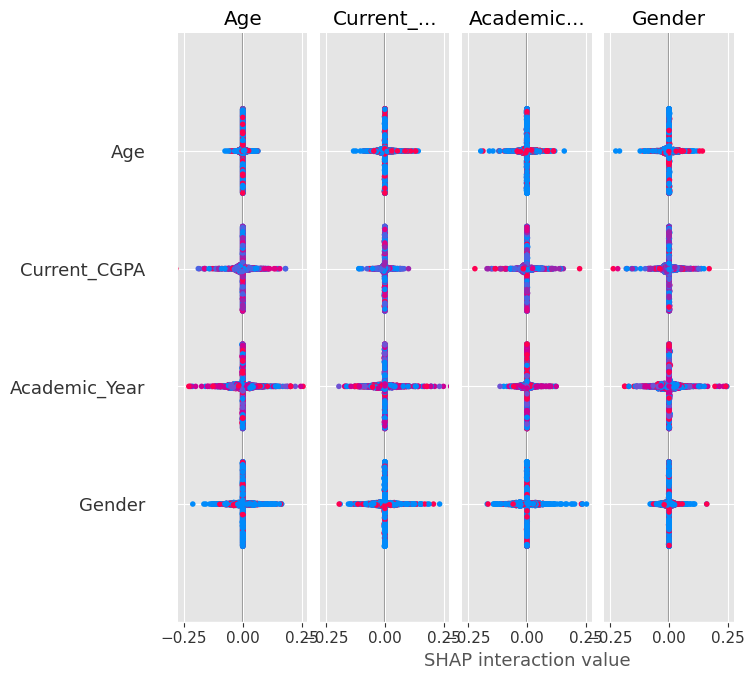

In [ ]:
import shap
from sklearn.svm import SVC

# Train an SVM model with the best parameters
best_svm = SVC(C=1, kernel='linear', gamma='scale', probability=True)
best_svm.fit(X_train, Y_train)

# Use KernelExplainer for multiclass classification
explainer = shap.KernelExplainer(best_svm.predict_proba, X_train)

# Calculate SHAP values
shap_values = explainer.shap_values(X_train, nsamples=100)

# Visualize the SHAP explanations
shap.summary_plot(shap_values, X_train, class_names=best_svm.classes_)
